In [1]:
import sys
import os
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import cm
import matplotlib as mpl
import matplotlib.patches as patches
from shapely.geometry import Point
from shapely.geometry import MultiPoint
from shapely.geometry import MultiPolygon
from shapely.geometry import Polygon
from shapely.geometry import box
from descartes.patch import PolygonPatch
import ipywidgets as widgets
import ipywidgets.widgets.interaction
#from ipywidgets import interactive, fixed
from ipywidgets import *
import random
import pandas as pd

import re

from shapely import geometry
import pickle
import time

#from ipyparallel import Client

from shapely import affinity
from shapely.geometry import LineString
import warnings
warnings.simplefilter('ignore', np.RankWarning)


%load_ext autoreload

In [2]:
pwd()

'/media/charly/Data/Lab/Projects/uJ/experiments_ms_pBGT/MGGT-AMP-Pulse'

In [3]:
path_to_uj="/home/esb/Projects/uJ/local/current/uJ_src_SingleChan/python/"
path_to_uj='/home/charly/Lab/Projects/uJ/local/current/uJ_src_SingleChan/python/'

sys.path.insert(0, path_to_uj)


In [4]:
%autoreload 2
from readroi import *
from DataManagers import *
from TrackingFunctions import *
from PlottingFunctions import *
from AnalysisFunctions import *

Importing readroi
DataStructs...1loaded!
DataManagers...loaded!
TrackingFunctions... 1loaded!
PlottingFunctions... loaded p2!
> Analysis Functions loaded


## Experiment Parameters

In [5]:

uj_data_path="/home/charly/Lab/Projects/uJ/uJ_data/"
#uj_data_path="/home/charly/Lab/Projects/uJ/uJ_data_online/"


expeLabel="MGGT-AMP-Pulse"

rootDir=uj_data_path+"MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/"

trap_list="xy01,xy04,xy05,xy06,xy07,xy09,xy12,xy13".split(",")

print(rootDir)


toFile=True
#Parameters 

frame2min=10

figxlim=640
figylim=512
flims=(figxlim,figylim)


frame_experiment_start=10;
frame_experiment_end=34
frame_signal_start=16
frame_signal_end=20
frame_norm_start=10
frame_norm_end=15                  ### trick
frame_analysis_end=34



t_experiment_start=0
t_signal_start=(frame_signal_start-frame_experiment_start)*frame2min  
t_signal_end=(frame_signal_end-frame_experiment_start)*frame2min
t_experiment_end=(frame_experiment_end-frame_experiment_start)*frame2min

frames=range(int(frame_experiment_start),int(frame_experiment_end+1))
frames_list=[x for x in frames]
times=[(this_frame-frame_experiment_start)*frame2min for this_frame in frames]
times_hour=[(this_frame-frame_experiment_start)*frame2min/60 for this_frame in frames]




data_type="normData"


dirNameTimeSeries_Imgs=rootDir+'figures/lineages/time_series/'
if not os.path.exists(dirNameTimeSeries_Imgs):
    print("making dir TimeSeriesImages...")
    os.makedirs(dirNameTimeSeries_Imgs)

dirNameDATALINEAGES=rootDir+'data/lineages/'
if not os.path.exists(dirNameDATALINEAGES):
    print("making dir lineages...")
    os.makedirs(dirNameDATALINEAGES)

#Prepare file system
dataPath="%sdata/GFP/"%rootDir


/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/
making dir lineages...


# uJ_Visualizer

### Load tracked cells

In [6]:
max_frames=-1

trap_tracked_cells=[]
for trap in trap_list:
    dirNameTRACKEDCELLS=rootDir+'data_cells_tracked/'+trap+"/"+data_type+"/"
    print(dirNameTRACKEDCELLS)
    tracked_cells=load_cells(dirNameTRACKEDCELLS,max_frames)
    trap_tracked_cells.append(tracked_cells)

0: Loading MGGT-AMP-Pulse_xy01_010.pkl
1: Loading MGGT-AMP-Pulse_xy01_011.pkl
2: Loading MGGT-AMP-Pulse_xy01_012.pkl
3: Loading MGGT-AMP-Pulse_xy01_013.pkl
4: Loading MGGT-AMP-Pulse_xy01_014.pkl
5: Loading MGGT-AMP-Pulse_xy01_015.pkl
6: Loading MGGT-AMP-Pulse_xy01_016.pkl
7: Loading MGGT-AMP-Pulse_xy01_017.pkl
8: Loading MGGT-AMP-Pulse_xy01_018.pkl
9: Loading MGGT-AMP-Pulse_xy01_019.pkl
10: Loading MGGT-AMP-Pulse_xy01_020.pkl
11: Loading MGGT-AMP-Pulse_xy01_021.pkl
12: Loading MGGT-AMP-Pulse_xy01_022.pkl
13: Loading MGGT-AMP-Pulse_xy01_023.pkl
14: Loading MGGT-AMP-Pulse_xy01_024.pkl
15: Loading MGGT-AMP-Pulse_xy01_025.pkl
16: Loading MGGT-AMP-Pulse_xy01_026.pkl
17: Loading MGGT-AMP-Pulse_xy01_027.pkl
18: Loading MGGT-AMP-Pulse_xy01_028.pkl
19: Loading MGGT-AMP-Pulse_xy01_029.pkl
20: Loading MGGT-AMP-Pulse_xy01_030.pkl
21: Loading MGGT-AMP-Pulse_xy01_031.pkl
22: Loading MGGT-AMP-Pulse_xy01_032.pkl
23: Loading MGGT-AMP-Pulse_xy01_033.pkl
24: Loading MGGT-AMP-Pulse_xy01_034.pkl
0: Loading

In [ ]:
len(tracked_cells)

In [ ]:
# del sys.modules['TrackingFunctions']
# from TrackingFunctions import *

In [9]:
#trap_list=trap_list[1:2]
#trap_list

['xy04']

# Make the lineages

In [7]:
trap_lineages=[]
for i,trap in enumerate(trap_list):
    tracked_cells=trap_tracked_cells[i]
    this_lineages=make_cellLineages_all(tracked_cells,frame_experiment_start)
    trap_lineages.append(this_lineages)
    print(len(this_lineages))


Making lineages of 49 cells from frame 24 out of 49

 ['34.000']	........................
 ['34.001']	........................
 ['34.002']	..*2 - 1
 ['34.003']	......*2 - 1
 ['34.004']	........................
 ['34.005']	....*3 - 1
 ['34.006']	.*3 - 2
 ['34.007']	.*3 - 1
 ['34.008']	..*3 - 1
 ['34.009']	..*3 - 1
 ['34.010']	........................
 ['34.011']	......*4 - 3
 ['34.012']	.*4 - 4
 ['34.013']	...*4 - 2
 ['34.014']	........................
 ['34.015']	........*5 - 1
 ['34.016']	...*5 - 4
 ['34.017']	.*5 - 4
 ['34.018']	.......*5 - 1
 ['34.019']	......*5 - 1
 ['34.020']	........................
 ['34.021']	..*6 - 3
 ['34.022']	..................*6 - 1
 ['34.023']	.*6 - 1
 ['34.024']	....*6 - 1
 ['34.025']	...*6 - 6
 ['34.026']	.*6 - 6
 ['34.027']	.....*6 - 4
 ['34.028']	.*6 - 6
 ['34.029']	....*6 - 1
 ['34.030']	..*6 - 1
 ['34.031']	.*6 - 2
 ['34.032']	..*6 - 1
 ['34.033']	..*6 - 2
 ['34.034']	.....*6 - 6
 ['34.035']	...*6 - 6
 ['34.036']	..*6 - 6
 ['34.037']	..............

 ['34.130']	.......*29 - 21
 ['34.131']	.*29 - 19
 ['34.132']	......*29 - 26
 ['34.133']	......*29 - 29
 ['34.134']	........................
 ['34.135']	........................
 ['34.136']	.......*31 - 26
 ['34.137']	........*31 - 27
 ['34.138']	.........*31 - 18
 ['34.139']	.*31 - 29
 ['34.140']	.....*31 - 19
 ['34.141']	........*31 - 18
 ['34.142']	.*31 - 19
 ['34.143']	........................
 ['34.144']	....*32 - 10
 ['34.145']	..*32 - 22
 ['34.146']	........................
 ['34.147']	..*33 - 21
 ['34.148']	........................
 ['34.149']	.................*34 - 34
 ['34.150']	......*34 - 26
 ['34.151']	.....................*34 - 29
 ['34.152']	........................
 ['34.153']	........................
 ['34.154']	........................
 ['34.155']	.*37 - 31
 ['34.156']	........................
 ['34.157']	.*38 - 30
 ['34.158']	........*38 - 37
 ['34.159']	......*38 - 28
 ['34.160']	.*38 - 26
 ['34.161']	.*38 - 11
 ['34.162']	...*38 - 27
 ['34.163']	...................

 ['30.222']	....................
 ['30.225']	.*56 - 34
 ['30.234']	.*56 - 39
 ['30.235']	.*56 - 44
 ['30.246']	....*56 - 34
 ['30.255']	..*56 - 53
 ['30.261']	..*56 - 38
 ['30.263']	......*56 - 46
 ['30.265']	......*56 - 46
 ['30.266']	..*56 - 46
Making lineages of 35 cells from frame 19 out of 257

 ['29.003']	.......*56 - 51
 ['29.007']	.*56 - 8
 ['29.008']	.*56 - 8
 ['29.013']	....*56 - 14
 ['29.016']	.*56 - 5
 ['29.022']	.*56 - 51
 ['29.035']	.*56 - 5
 ['29.037']	.*56 - 5
 ['29.039']	..*56 - 2
 ['29.041']	..*56 - 5
 ['29.053']	.*56 - 51
 ['29.056']	.*56 - 4
 ['29.059']	.......*56 - 5
 ['29.065']	..*56 - 24
 ['29.070']	.*56 - 54
 ['29.074']	.*56 - 12
 ['29.075']	.*56 - 14
 ['29.096']	.*56 - 19
 ['29.097']	.*56 - 19
 ['29.123']	.*56 - 26
 ['29.131']	.*56 - 19
 ['29.155']	.*56 - 26
 ['29.158']	...*56 - 47
 ['29.178']	.*56 - 36
 ['29.184']	..*56 - 44
 ['29.187']	....*56 - 26
 ['29.198']	....*56 - 39
 ['29.206']	...*56 - 38
 ['29.215']	..*56 - 39
 ['29.218']	.*56 - 34
 ['29.230']	....*5

 ['19.161']	.........
 ['19.162']	.....*123 - 69
 ['19.165']	.........
 ['19.166']	......*124 - 123
 ['19.168']	.........
 ['19.176']	......*125 - 84
 ['19.180']	.........
 ['19.186']	....*126 - 83
 ['19.187']	...*126 - 126
 ['19.188']	..*126 - 66
 ['19.189']	.........
 ['19.190']	.*127 - 126
 ['19.191']	.....*127 - 50
 ['19.193']	.......*127 - 45
 ['19.195']	.........
 ['19.199']	....*128 - 84
 ['19.200']	.......*128 - 109
 ['19.202']	..*128 - 48
 ['19.205']	...*128 - 50
 ['19.207']	....*128 - 53
 ['19.210']	.*128 - 111
 ['19.213']	.........
 ['19.223']	....*129 - 49
Making lineages of 44 cells from frame 8 out of 247

 ['18.000']	......*129 - 91
 ['18.003']	......*129 - 87
 ['18.005']	....*129 - 86
 ['18.006']	........
 ['18.008']	..*130 - 101
 ['18.009']	........
 ['18.016']	.......*131 - 131
 ['18.018']	..*131 - 131
 ['18.033']	........
 ['18.034']	..*132 - 132
 ['18.036']	.*132 - 115
 ['18.042']	..*132 - 7
 ['18.051']	........
 ['18.056']	......*133 - 103
 ['18.060']	..*133 - 79
 

 ['13.239']	...
 ['13.240']	...
 ['13.246']	..*224 - 139
 ['13.256']	...
 ['13.259']	.*225 - 122
 ['13.260']	.*225 - 84
 ['13.269']	...
 ['13.271']	...
 ['13.285']	...
 ['13.293']	..*228 - 201
 ['13.298']	...
 ['13.302']	...
 ['13.304']	..*230 - 76
 ['13.305']	.*230 - 160
 ['13.321']	...
 ['13.323']	..*231 - 231
 ['13.326']	..*231 - 158
 ['13.328']	..*231 - 158
 ['13.332']	..*231 - 142
 ['13.333']	...
 ['13.335']	.*232 - 142
Making lineages of 50 cells from frame 2 out of 327

 ['12.000']	.*232 - 186
 ['12.003']	..
 ['12.004']	.*233 - 87
 ['12.008']	.*233 - 187
 ['12.009']	..
 ['12.022']	..
 ['12.028']	.*235 - 131
 ['12.031']	.*235 - 117
 ['12.032']	..
 ['12.036']	.*236 - 148
 ['12.040']	.*236 - 233
 ['12.041']	..
 ['12.047']	.*237 - 7
 ['12.048']	..
 ['12.065']	..
 ['12.066']	.*239 - 238
 ['12.071']	..
 ['12.072']	..
 ['12.074']	..
 ['12.078']	.*242 - 239
 ['12.079']	..
 ['12.085']	..
 ['12.090']	..
 ['12.096']	..
 ['12.098']	.*246 - 5
 ['12.099']	..
 ['12.102']	..
 ['12.159']	.*248 -

 ['34.217']	.......*40 - 22
 ['34.218']	........................
 ['34.219']	........................
 ['34.220']	.*42 - 19
 ['34.221']	....*42 - 42
 ['34.222']	....*42 - 17
 ['34.223']	......*42 - 38
 ['34.224']	........*42 - 24
 ['34.225']	...*42 - 24
 ['34.226']	......*42 - 24
 ['34.227']	.....................*42 - 40
 ['34.228']	.....*42 - 35
 ['34.229']	.....................*42 - 30
 ['34.230']	...*42 - 39
 ['34.231']	................*42 - 38
 ['34.232']	..*42 - 38
 ['34.233']	.*42 - 42
 ['34.234']	......*42 - 22
 ['34.235']	.....*42 - 17
 ['34.236']	.*42 - 27
 ['34.237']	..*42 - 32
 ['34.238']	...*42 - 37
 ['34.239']	..........*42 - 34
 ['34.240']	....*42 - 23
 ['34.241']	.............*42 - 35
 ['34.242']	........................
 ['34.243']	.*43 - 39
 ['34.244']	...*43 - 33
 ['34.245']	.........*43 - 30
 ['34.246']	.*43 - 38
 ['34.247']	..*43 - 27
 ['34.248']	.........*43 - 18
 ['34.249']	......*43 - 24
 ['34.250']	..*43 - 34
 ['34.251']	........*43 - 43
 ['34.252']	......*43 - 

 ['28.020']	...*56 - 4
 ['28.026']	..*56 - 2
 ['28.029']	.*56 - 4
 ['28.037']	.*56 - 2
 ['28.038']	..*56 - 11
 ['28.045']	.*56 - 12
 ['28.047']	...*56 - 12
 ['28.061']	.*56 - 52
 ['28.067']	...*56 - 13
 ['28.068']	.*56 - 12
 ['28.069']	.*56 - 16
 ['28.072']	...*56 - 4
 ['28.108']	..*56 - 50
 ['28.112']	.*56 - 4
 ['28.114']	...*56 - 1
 ['28.117']	....*56 - 23
 ['28.119']	.*56 - 10
 ['28.128']	.*56 - 7
 ['28.138']	.*56 - 13
 ['28.140']	...*56 - 36
 ['28.152']	..*56 - 53
 ['28.163']	..*56 - 18
 ['28.174']	......*56 - 39
 ['28.178']	.*56 - 23
 ['28.179']	.*56 - 43
 ['28.180']	.....*56 - 43
 ['28.204']	.....*56 - 24
 ['28.217']	.*56 - 43
 ['28.244']	...*56 - 51
 ['28.245']	..*56 - 56
 ['28.253']	.*56 - 56
 ['28.254']	...*56 - 44
 ['28.259']	..*56 - 46
 ['28.260']	...*56 - 44
Making lineages of 45 cells from frame 17 out of 258

 ['27.003']	...*56 - 8
 ['27.004']	..*56 - 8
 ['27.005']	.*56 - 1
 ['27.008']	.*56 - 9
 ['27.013']	.*56 - 2
 ['27.016']	..*56 - 5
 ['27.030']	.*56 - 1
 ['27.032']	.*

 ['20.224']	......*104 - 80
 ['20.225']	..*104 - 40
 ['20.231']	..........
 ['20.236']	...*105 - 105
 ['20.238']	......*105 - 35
 ['20.240']	........*105 - 46
 ['20.241']	..*105 - 46
 ['20.243']	..........
 ['20.245']	...*106 - 46
 ['20.251']	........*106 - 34
 ['20.252']	..........
 ['20.253']	..........
Making lineages of 58 cells from frame 9 out of 271

 ['19.001']	.........
 ['19.002']	....*109 - 75
 ['19.005']	.........
 ['19.009']	.........
 ['19.010']	.*111 - 75
 ['19.022']	......*111 - 65
 ['19.023']	...*111 - 2
 ['19.024']	.*111 - 6
 ['19.025']	...*111 - 54
 ['19.026']	..*111 - 54
 ['19.039']	..*111 - 87
 ['19.041']	..*111 - 9
 ['19.042']	........*111 - 95
 ['19.047']	...*111 - 95
 ['19.049']	.*111 - 54
 ['19.051']	........*111 - 5
 ['19.052']	..*111 - 12
 ['19.057']	........*111 - 93
 ['19.060']	.*111 - 86
 ['19.069']	....*111 - 15
 ['19.070']	..*111 - 96
 ['19.076']	.*111 - 96
 ['19.081']	.......*111 - 52
 ['19.084']	.........
 ['19.091']	.*112 - 69
 ['19.094']	....*112 - 8

 ['13.012']	...
 ['13.015']	...
 ['13.020']	...
 ['13.023']	..*185 - 121
 ['13.025']	...
 ['13.041']	..*186 - 84
 ['13.045']	.*186 - 4
 ['13.049']	...
 ['13.051']	.*187 - 65
 ['13.058']	...
 ['13.060']	...
 ['13.062']	...
 ['13.071']	...
 ['13.074']	...
 ['13.077']	..*192 - 191
 ['13.089']	.*192 - 15
 ['13.093']	.*192 - 127
 ['13.097']	.*192 - 170
 ['13.101']	...
 ['13.106']	..*193 - 5
 ['13.107']	...
 ['13.113']	...
 ['13.115']	.*195 - 175
 ['13.116']	.*195 - 64
 ['13.125']	...
 ['13.134']	..*196 - 28
 ['13.138']	.*196 - 138
 ['13.139']	..*196 - 57
 ['13.140']	..*196 - 64
 ['13.159']	.*196 - 101
 ['13.169']	.*196 - 18
 ['13.176']	...
 ['13.183']	..*197 - 67
 ['13.186']	...
 ['13.192']	...
 ['13.202']	..*199 - 13
 ['13.211']	..*199 - 80
 ['13.219']	.*199 - 49
 ['13.227']	...
 ['13.231']	...
 ['13.233']	...
 ['13.246']	.*202 - 201
 ['13.247']	...
 ['13.251']	...
 ['13.252']	...
 ['13.256']	..*205 - 128
 ['13.268']	...
 ['13.276']	..*206 - 82
 ['13.285']	...
 ['13.287']	.*207 - 81
 ['13.

 ['33.072']	...*37 - 2
 ['33.073']	..*37 - 4
 ['33.075']	..*37 - 11
 ['33.076']	....*37 - 7
 ['33.078']	.......*37 - 24
 ['33.089']	.*37 - 23
 ['33.090']	.*37 - 13
 ['33.100']	........*37 - 10
 ['33.111']	.........*37 - 20
 ['33.112']	..*37 - 20
 ['33.113']	.*37 - 23
 ['33.119']	.*37 - 15
 ['33.126']	.*37 - 23
 ['33.128']	.*37 - 29
 ['33.130']	.*37 - 16
 ['33.144']	..*37 - 23
 ['33.168']	.*37 - 24
 ['33.181']	.*37 - 28
 ['33.183']	.........*37 - 34
 ['33.185']	.......................
 ['33.191']	.........*38 - 28
 ['33.199']	.....*38 - 28
 ['33.200']	........*38 - 28
 ['33.201']	.*38 - 34
 ['33.202']	..*38 - 28
 ['33.203']	......*38 - 31
 ['33.204']	..*38 - 28
Making lineages of 21 cells from frame 22 out of 185

 ['32.025']	.........*38 - 18
 ['32.030']	.......*38 - 13
 ['32.033']	.*38 - 13
 ['32.035']	.*38 - 7
 ['32.039']	.*38 - 4
 ['32.044']	.*38 - 7
 ['32.046']	..*38 - 7
 ['32.052']	.*38 - 7
 ['32.058']	.*38 - 21
 ['32.067']	.*38 - 15
 ['32.073']	.*38 - 7
 ['32.096']	.*38 - 24
 ['3

 ['20.128']	.........*71 - 63
 ['20.129']	.......*71 - 57
 ['20.138']	..*71 - 38
Making lineages of 40 cells from frame 9 out of 168

 ['19.000']	........*71 - 56
 ['19.001']	.....*71 - 58
 ['19.006']	...*71 - 19
 ['19.008']	.........
 ['19.012']	...*72 - 58
 ['19.013']	.........
 ['19.015']	.........
 ['19.021']	.........
 ['19.024']	...*75 - 52
 ['19.026']	.*75 - 75
 ['19.028']	.*75 - 49
 ['19.032']	.........
 ['19.038']	.........
 ['19.040']	........*77 - 9
 ['19.041']	........*77 - 75
 ['19.044']	.........
 ['19.045']	.........
 ['19.046']	......*79 - 67
 ['19.048']	....*79 - 52
 ['19.061']	.*79 - 14
 ['19.064']	...*79 - 52
 ['19.068']	.........
 ['19.072']	.*80 - 52
 ['19.074']	......*80 - 20
 ['19.084']	.*80 - 60
 ['19.086']	.........
 ['19.089']	..*81 - 40
 ['19.098']	.*81 - 43
 ['19.104']	.*81 - 52
 ['19.105']	.*81 - 60
 ['19.116']	.........
 ['19.117']	.........
 ['19.128']	..*83 - 47
 ['19.144']	...*83 - 38
 ['19.149']	.*83 - 57
 ['19.152']	.*83 - 38
 ['19.159']	.........
 ['

 ['34.073']	..*15 - 13
 ['34.074']	.*15 - 13
 ['34.075']	.......*15 - 10
 ['34.076']	.*15 - 8
 ['34.077']	...*15 - 3
 ['34.078']	.*15 - 13
 ['34.079']	..*15 - 15
 ['34.080']	........................
 ['34.081']	.*16 - 11
 ['34.082']	....*16 - 13
 ['34.083']	...*16 - 10
 ['34.084']	...*16 - 13
 ['34.085']	.........*16 - 12
 ['34.086']	.................*16 - 10
 ['34.087']	......*16 - 11
 ['34.088']	.*16 - 13
 ['34.089']	.*16 - 3
 ['34.090']	..............*16 - 13
 ['34.091']	..................*16 - 14
 ['34.092']	.....*16 - 14
 ['34.093']	...*16 - 8
 ['34.094']	.*16 - 13
 ['34.095']	.........*16 - 9
 ['34.096']	....*16 - 3
 ['34.097']	.*16 - 8
 ['34.098']	....*16 - 10
 ['34.099']	.....*16 - 16
 ['34.100']	........*16 - 10
 ['34.101']	...*16 - 13
 ['34.102']	....*16 - 13
 ['34.103']	.........*16 - 10
 ['34.104']	...*16 - 3
 ['34.105']	.............*16 - 10
 ['34.106']	......*16 - 14
 ['34.107']	..*16 - 13
 ['34.108']	..*16 - 14
 ['34.109']	.*16 - 10
 ['34.110']	..*16 - 10
 ['34.111']	.*1

 ['29.167']	..*28 - 18
 ['29.182']	..*28 - 18
 ['29.184']	...*28 - 22
 ['29.185']	..*28 - 26
Making lineages of 40 cells from frame 18 out of 195

 ['28.000']	..................
 ['28.001']	............*29 - 2
 ['28.018']	.*29 - 5
 ['28.025']	.*29 - 3
 ['28.033']	.*29 - 4
 ['28.036']	.*29 - 8
 ['28.037']	..*29 - 16
 ['28.039']	..*29 - 5
 ['28.042']	..*29 - 13
 ['28.045']	.*29 - 1
 ['28.050']	..*29 - 14
 ['28.064']	....*29 - 8
 ['28.067']	.*29 - 11
 ['28.071']	.*29 - 13
 ['28.072']	.*29 - 10
 ['28.074']	.*29 - 13
 ['28.076']	.*29 - 10
 ['28.078']	.*29 - 10
 ['28.083']	.*29 - 17
 ['28.085']	.*29 - 10
 ['28.100']	.*29 - 10
 ['28.108']	..*29 - 19
 ['28.113']	..*29 - 10
 ['28.126']	.*29 - 13
 ['28.128']	..*29 - 10
 ['28.131']	..*29 - 10
 ['28.137']	.*29 - 14
 ['28.138']	.*29 - 10
 ['28.139']	.*29 - 22
 ['28.146']	.*29 - 24
 ['28.149']	.*29 - 20
 ['28.151']	.*29 - 10
 ['28.153']	..*29 - 23
 ['28.159']	............*29 - 26
 ['28.176']	.*29 - 22
 ['28.187']	.*29 - 25
 ['28.190']	..*29 - 20
 ['

 ['16.092']	..*62 - 35
 ['16.101']	.....*62 - 62
 ['16.102']	...*62 - 53
 ['16.103']	.*62 - 62
 ['16.104']	......
 ['16.106']	.*63 - 18
 ['16.112']	.*63 - 18
 ['16.114']	......
 ['16.116']	...*64 - 23
 ['16.122']	.*64 - 18
 ['16.126']	.*64 - 18
 ['16.127']	.*64 - 57
 ['16.130']	.*64 - 22
 ['16.141']	..*64 - 22
 ['16.148']	.*64 - 20
 ['16.149']	..*64 - 26
 ['16.150']	...*64 - 55
 ['16.151']	...*64 - 22
 ['16.152']	.*64 - 18
 ['16.154']	..*64 - 54
 ['16.155']	.*64 - 26
Making lineages of 22 cells from frame 5 out of 141

 ['15.012']	.*64 - 48
 ['15.015']	.....
 ['15.018']	.*65 - 2
 ['15.019']	.*65 - 38
 ['15.027']	.....
 ['15.031']	...*66 - 45
 ['15.048']	..*66 - 13
 ['15.058']	..*66 - 13
 ['15.083']	..*66 - 40
 ['15.084']	.....
 ['15.085']	...*67 - 19
 ['15.089']	..*67 - 53
 ['15.096']	.*67 - 53
 ['15.100']	..*67 - 62
 ['15.103']	.*67 - 18
 ['15.107']	...*67 - 41
 ['15.116']	.*67 - 55
 ['15.117']	...*67 - 37
 ['15.120']	.*67 - 18
 ['15.121']	.....
 ['15.122']	.....
 ['15.123']	...*69 - 

 ['34.202']	......*31 - 27
 ['34.203']	.....*31 - 25
 ['34.204']	....*31 - 15
 ['34.205']	.........*31 - 15
 ['34.206']	...*31 - 28
 ['34.207']	..*31 - 14
 ['34.208']	........................
 ['34.209']	......*32 - 30
 ['34.210']	.......*32 - 23
 ['34.211']	......*32 - 27
 ['34.212']	........................
 ['34.213']	........................
 ['34.214']	......*34 - 15
 ['34.215']	...*34 - 27
 ['34.216']	...........*34 - 11
 ['34.217']	.............*34 - 33
 ['34.218']	.*34 - 11
 ['34.219']	...*34 - 23
 ['34.220']	.*34 - 19
 ['34.221']	........................
 ['34.222']	.....*35 - 6
 ['34.223']	........*35 - 11
 ['34.224']	......*35 - 29
 ['34.225']	.*35 - 30
 ['34.226']	........................
 ['34.227']	.*36 - 6
 ['34.228']	........*36 - 14
 ['34.229']	..*36 - 27
 ['34.230']	.*36 - 25
 ['34.231']	.....*36 - 34
 ['34.232']	..........*36 - 27
 ['34.233']	........................
 ['34.234']	........*37 - 23
 ['34.235']	........*37 - 29
 ['34.236']	........*37 - 34
 ['34.237']	..

 ['27.061']	.*45 - 10
 ['27.077']	....*45 - 18
 ['27.084']	.*45 - 6
 ['27.086']	..*45 - 25
 ['27.093']	.*45 - 6
 ['27.106']	.*45 - 11
 ['27.118']	.................
 ['27.131']	.*46 - 27
 ['27.138']	.*46 - 27
 ['27.148']	.....*46 - 40
 ['27.155']	.*46 - 33
 ['27.156']	.*46 - 29
Making lineages of 16 cells from frame 16 out of 112

 ['26.017']	.....*46 - 13
 ['26.027']	...*46 - 17
 ['26.031']	.*46 - 22
 ['26.032']	.*46 - 1
 ['26.033']	.............*46 - 25
 ['26.043']	.*46 - 6
 ['26.044']	...........*46 - 24
 ['26.050']	......*46 - 13
 ['26.062']	........*46 - 23
 ['26.092']	.*46 - 27
 ['26.095']	.*46 - 33
 ['26.102']	...*46 - 36
 ['26.106']	..*46 - 39
 ['26.108']	..*46 - 42
 ['26.109']	.*46 - 36
 ['26.111']	................
Making lineages of 21 cells from frame 15 out of 114

 ['25.000']	.........*47 - 5
 ['25.006']	.....*47 - 22
 ['25.007']	.....*47 - 1
 ['25.020']	..*47 - 3
 ['25.024']	......*47 - 3
 ['25.025']	..*47 - 3
 ['25.036']	....*47 - 7
 ['25.060']	..*47 - 19
 ['25.064']	.*47

 ['17.032']	.......
 ['17.039']	.......
 ['17.042']	.*102 - 45
 ['17.045']	.*102 - 70
 ['17.046']	.*102 - 70
 ['17.055']	....*102 - 9
 ['17.058']	.......
 ['17.065']	....*103 - 98
 ['17.072']	..*103 - 18
 ['17.074']	.......
 ['17.076']	..*104 - 12
 ['17.088']	.......
 ['17.095']	......*105 - 5
 ['17.098']	...*105 - 14
 ['17.106']	...*105 - 14
 ['17.111']	...*105 - 6
 ['17.118']	..*105 - 60
 ['17.124']	.*105 - 20
 ['17.125']	.......
 ['17.129']	..*106 - 14
 ['17.130']	.*106 - 40
 ['17.133']	.*106 - 6
 ['17.137']	..*106 - 6
 ['17.139']	.*106 - 93
 ['17.143']	..*106 - 28
 ['17.144']	.*106 - 6
 ['17.147']	....*106 - 77
 ['17.151']	..*106 - 40
 ['17.157']	.*106 - 80
 ['17.159']	......*106 - 96
 ['17.160']	.......
 ['17.163']	.*107 - 79
 ['17.165']	...*107 - 44
 ['17.167']	.*107 - 95
 ['17.169']	...*107 - 94
 ['17.173']	.......
 ['17.174']	.*108 - 96
 ['17.175']	..*108 - 54
 ['17.176']	..*108 - 94
 ['17.179']	.*108 - 79
 ['17.182']	......*108 - 52
 ['17.186']	.*108 - 40
 ['17.189']	.*108 - 3

 ['11.048']	.
 ['11.050']	.
 ['11.051']	.
 ['11.053']	.
 ['11.054']	.
 ['11.055']	.
 ['11.057']	.
 ['11.058']	.
 ['11.066']	.
 ['11.076']	.
 ['11.077']	.
 ['11.078']	.
 ['11.079']	.
 ['11.080']	.
 ['11.092']	.
 ['11.094']	.
 ['11.097']	.
 ['11.116']	.
 ['11.117']	.
 ['11.135']	.
 ['11.143']	.
 ['11.153']	.
 ['11.154']	.
 ['11.159']	.
 ['11.161']	.
 ['11.165']	.
 ['11.178']	.
 ['11.203']	.
 ['11.206']	.
 ['11.210']	.
 ['11.211']	.
 ['11.223']	.
 ['11.227']	.
 ['11.231']	.
 ['11.243']	.
 ['11.247']	.
 ['11.250']	.
 ['11.252']	.
 ['11.259']	.
 ['11.262']	.
 ['11.271']	.
 ['11.272']	.
 ['11.282']	.
 ['11.288']	.
 ['11.290']	.
 ['11.292']	.
 ['11.293']	.
 ['11.299']	.
 ['11.300']	.5187

Lineage complete!
1308

Making lineages of 119 cells from frame 24 out of 119

 ['34.000']	........................
 ['34.001']	........................
 ['34.002']	........................
 ['34.003']	.....*3 - 2
 ['34.004']	.*3 - 3
 ['34.005']	....................*3 - 2
 ['34.006']	...*3 - 3
 ['34.007']	.*

In [8]:
print(trap_lineages[0][0])

{'trackID': '10.008-34.000', 'cellColor': '#9eeaa3', 'cellIDs': ['10.008', '11.006', '12.008', '13.008', '14.005', '15.005', '16.005', '17.004', '18.004', '19.005', '20.005', '21.005', '22.003', '23.004', '24.006', '25.005', '26.005', '27.004', '28.005', '29.004', '30.006', '31.004', '32.002', '33.000', '34.000'], 'roiID': ['roi_f10_n8_x129_y214', 'roi_f11_n6_x126_y216', 'roi_f12_n8_x122_y225', 'roi_f13_n8_x124_y224', 'roi_f14_n5_x124_y220', 'roi_f15_n5_x124_y219', 'roi_f16_n5_x125_y212', 'roi_f17_n4_x118_y231', 'roi_f18_n4_x119_y226', 'roi_f19_n5_x119_y224', 'roi_f20_n5_x118_y224', 'roi_f21_n5_x120_y218', 'roi_f22_n3_x119_y222', 'roi_f23_n4_x121_y215', 'roi_f24_n6_x121_y210', 'roi_f25_n5_x121_y213', 'roi_f26_n5_x123_y205', 'roi_f27_n4_x125_y229', 'roi_f28_n5_x128_y229', 'roi_f29_n4_x128_y229', 'roi_f30_n6_x124_y237', 'roi_f31_n4_x135_y246', 'roi_f32_n2_x146_y246', 'roi_f33_n0_x189_y263', 'roi_f34_n0_x188_y259'], 'roiFrames': [10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24,

### Export time-series

In [9]:
max_frames=frame_experiment_end-frame_experiment_start
minFrames=max_frames-2

for i,trap in enumerate(trap_list):
    this_lineages=trap_lineages[i]
    dirNameDATALINEAGES=rootDir+'data/lineages/'#+trap+"/"
    filename=dirNameDATALINEAGES+expeLabel+"_"+trap+"_lineages_all.csv"
    save_data_lineages(this_lineages,filename)
    print(len(this_lineages),"saved!")
    analysis_lineages=get_analysis_lineages(this_lineages, frame_signal_start,frame_signal_end,frame_experiment_start)
    filename=dirNameDATALINEAGES+expeLabel+"_"+trap+"_lineages_analysis.csv"
    save_data_lineages(analysis_lineages,filename)
    print(len(analysis_lineages),"saved!")
    long_lineages=get_long_lineages(this_lineages, minFrames)
    filename=dirNameDATALINEAGES+expeLabel+"_"+trap+"_lineages_long.csv"
    save_data_lineages(long_lineages,filename)
    print(len(long_lineages),"saved!")

Saving file /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy01_lineages_all.csv
155 saved!
Saving file /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy01_lineages_analysis.csv
21 saved!
Saving file /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy01_lineages_long.csv
8 saved!
Saving file /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy04_lineages_all.csv
1217 saved!
Saving file /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy04_lineages_analysis.csv
148 saved!
Saving file /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy04_lineages_long.csv
53 saved!
Saving file /home/charly/Lab/Projects/uJ/uJ

## Time Series Plots

### Fraction of dividing cells

24 19
155
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_divisions_timeseries_xy01.png


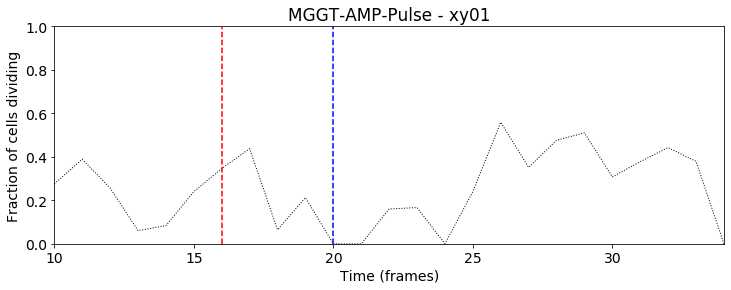

1217
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_divisions_timeseries_xy04.png


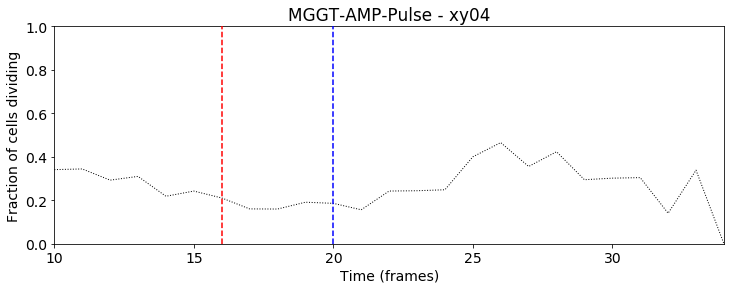

1372
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_divisions_timeseries_xy05.png


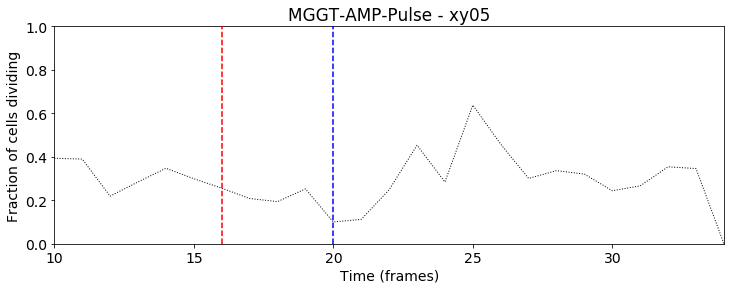

851
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_divisions_timeseries_xy06.png


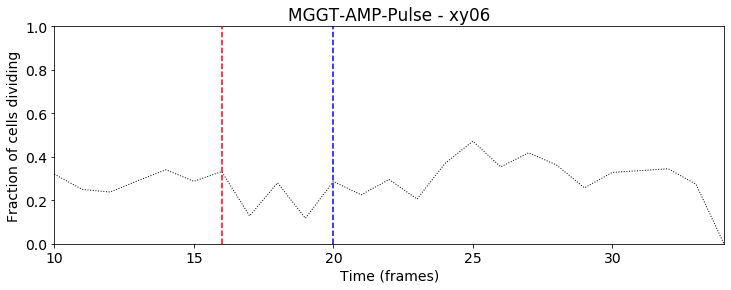

882
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_divisions_timeseries_xy07.png


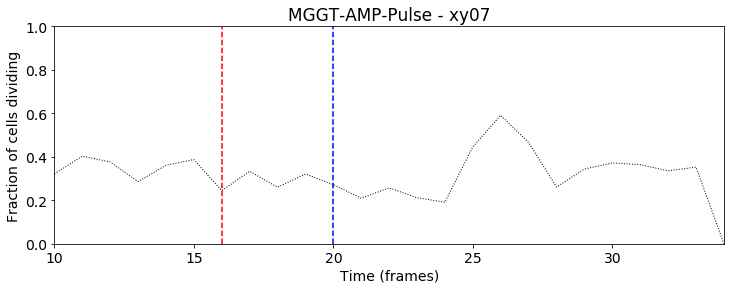

1308
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_divisions_timeseries_xy09.png


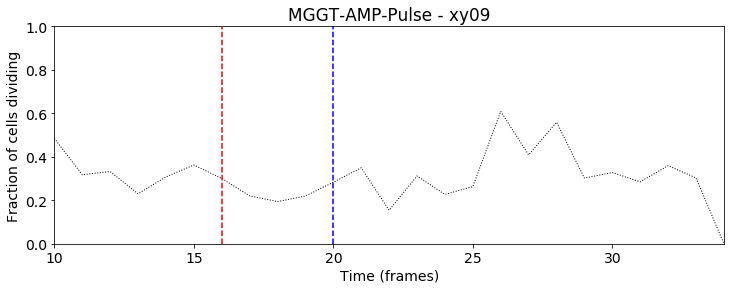

305
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_divisions_timeseries_xy12.png


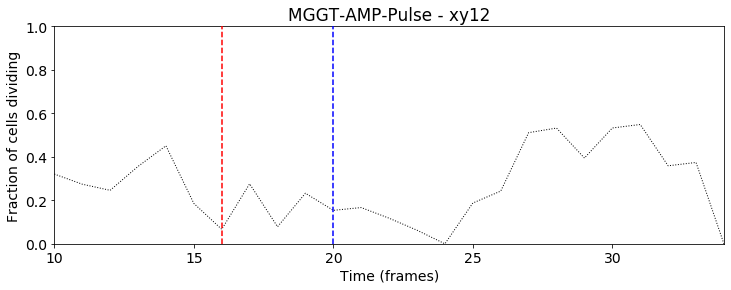

92
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_divisions_timeseries_xy13.png


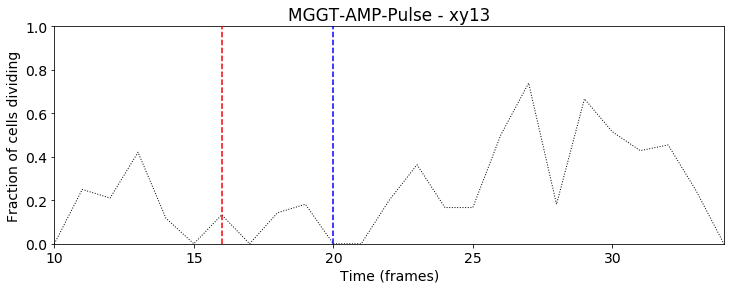

In [10]:
max_frames=frame_experiment_end-frame_experiment_start
minFrames=max_frames-5

print(max_frames,minFrames)
for i,trap in enumerate(trap_list):
    
    this_lineages=trap_lineages[i]
    #this_lineages=get_long_lineages(this_lineages, minFrames)
    print(len(this_lineages))
    
    mpl.rcParams.update({'font.size': 14})
    data_labels={'divisions'}
    for this_data_label in data_labels:
        #fileName="%s%s_%s_timeseries_%s.png"%(dirNameTimeSeries_Imgs,expeLabel,trap,this_data_label)
        fileName="%s%s_%s_timeseries_%s.png"%(dirNameTimeSeries_Imgs,expeLabel,this_data_label,trap)
        print(fileName)
        title="%s - %s"%(expeLabel,trap)
        fig=plot_cells_data_divs(this_lineages, this_data_label, fileName,frame_signal_start,frame_signal_end,frame_experiment_start, frame_experiment_end,frames_list,title)
            
        plt.show()


### Cells length

24 22
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_axis_timeseries_xy01.png


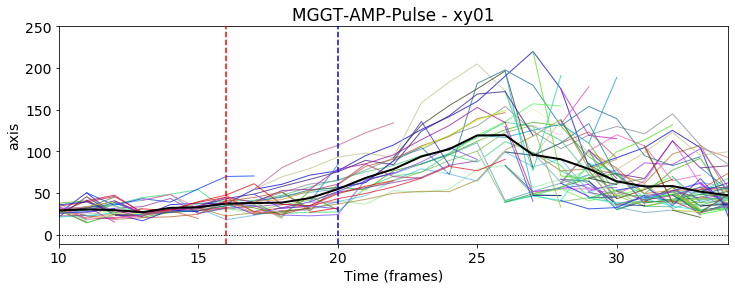

/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_axis_timeseries_xy04.png


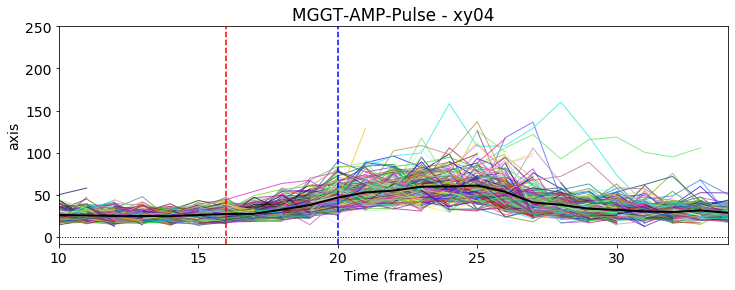

/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_axis_timeseries_xy05.png


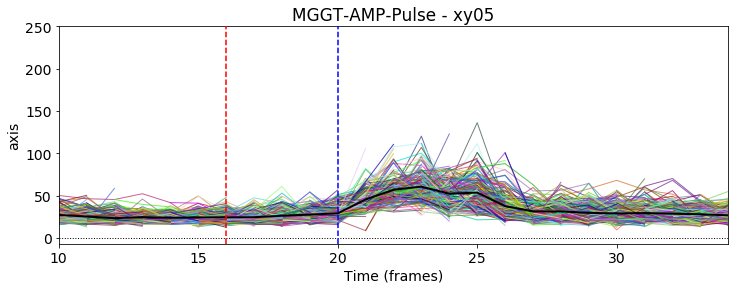

/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_axis_timeseries_xy06.png


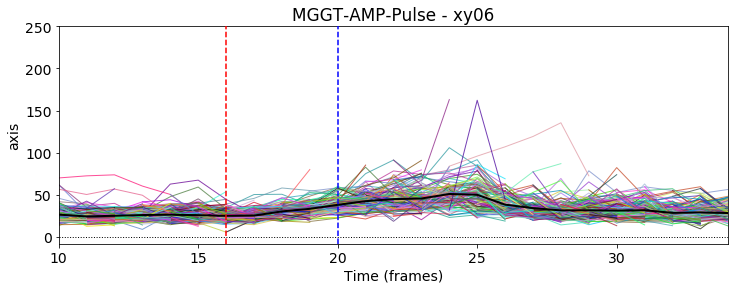

/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_axis_timeseries_xy07.png


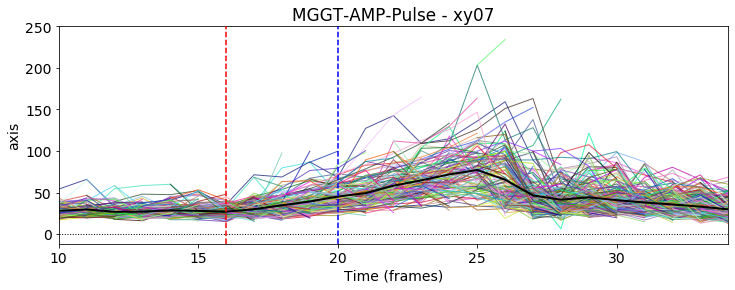

/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_axis_timeseries_xy09.png


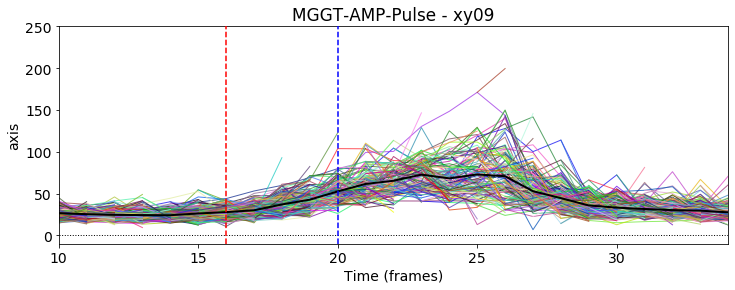

/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_axis_timeseries_xy12.png


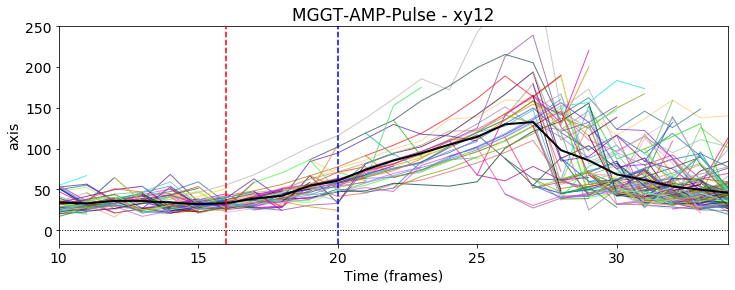

/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/lineages/time_series/MGGT-AMP-Pulse_axis_timeseries_xy13.png


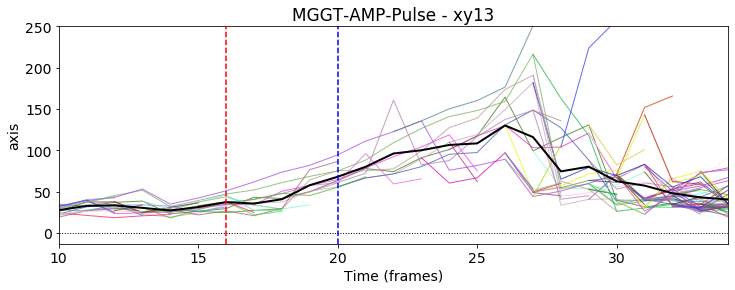

In [11]:
max_frames=frame_experiment_end-frame_experiment_start
minFrames=max_frames-2

length_threshold=250
print(max_frames,minFrames)
ylim=length_threshold
for i,trap in enumerate(trap_list):
    #print(trap)
    this_lineages=trap_lineages[i]
    #this_lineages=get_long_lineages(this_lineages, minFrames)
    nl=[]
    
    for lineage in this_lineages:
        if(lineage['axis'][0].length<length_threshold):
            nl.append(lineage)
            
    this_lineages=nl
    
   # this_lineages=random.sample(this_lineages,k=10)
    
    mpl.rcParams.update({'font.size': 14})
    data_labels={'axis'}
    for this_data_label in data_labels:
        #fileName="%s%s_%s_timeseries_%s.png"%(dirNameTimeSeries_Imgs,expeLabel,trap,this_data_label)
        fileName="%s%s_%s_timeseries_%s.png"%(dirNameTimeSeries_Imgs,expeLabel,this_data_label,trap)
        print(fileName)
        title="%s - %s"%(expeLabel,trap)
        fig=plot_cells_data_axis(this_lineages, this_data_label, fileName,frame_signal_start,frame_signal_end,frame_experiment_start, title,ylim)
        plt.show()

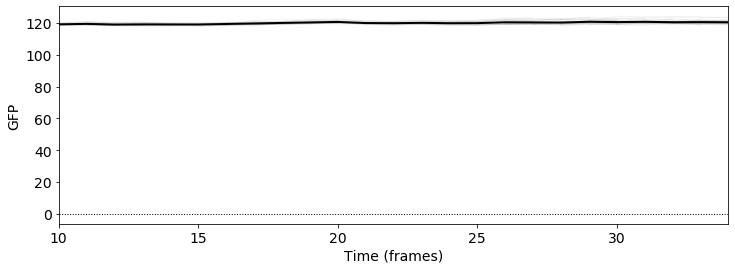

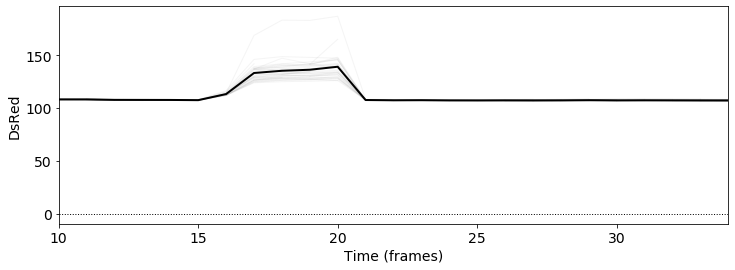

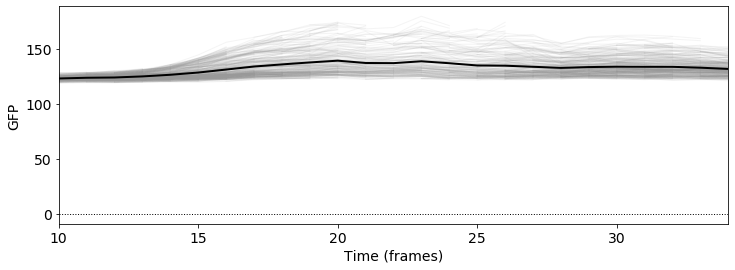

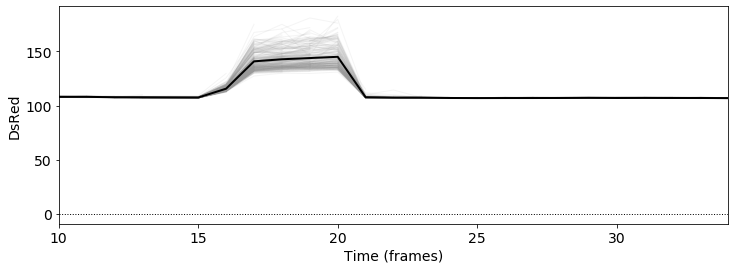

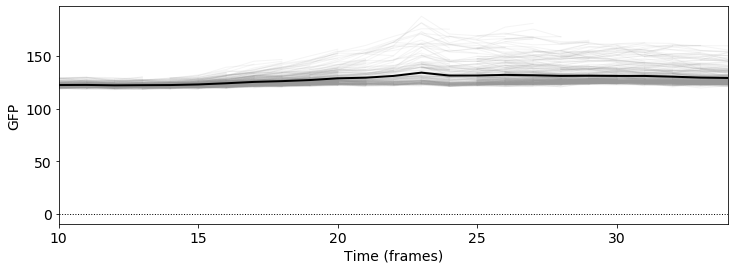

...

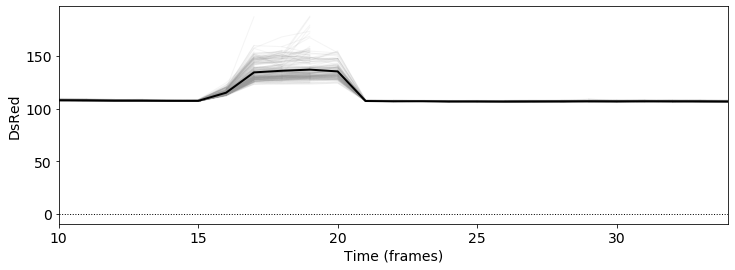

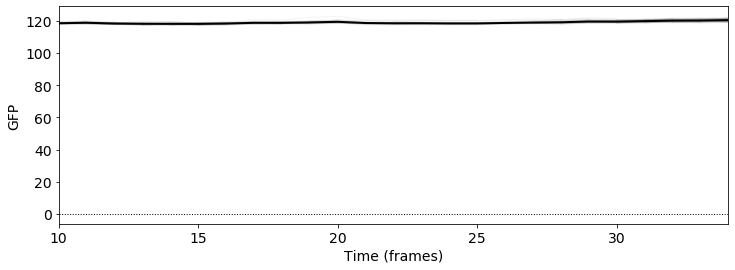

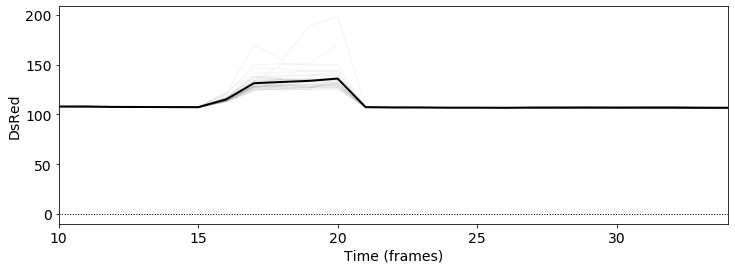

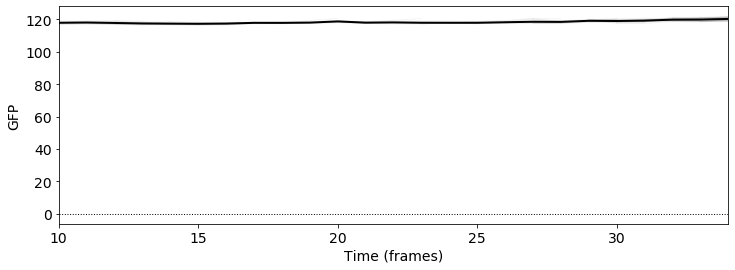

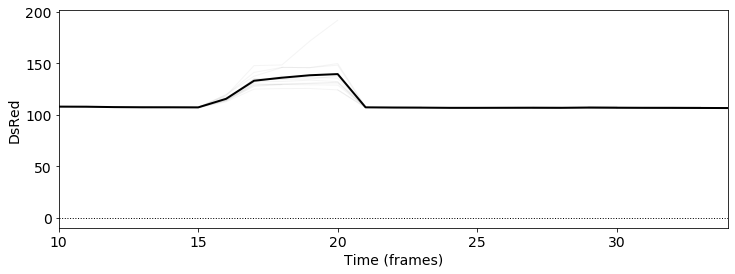

In [112]:
for i,trap in enumerate(trap_list):
    
    this_lineages=trap_lineages[i]
    mpl.rcParams.update({'font.size': 14})
    data_labels={'GFP','DsRed'}
    for this_data_label in data_labels:
        fileName="%s%s_%s_timeseries_%s.png"%(dirNameTimeSeries_Imgs,expeLabel,this_data_label,trap)
        plot_cells_data(this_lineages, this_data_label, fileName)
        plt.show()





### Poincare

/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/traked_cells/time_series/MGGT-AMP-Pulse_xy01_poincare_GFP.png


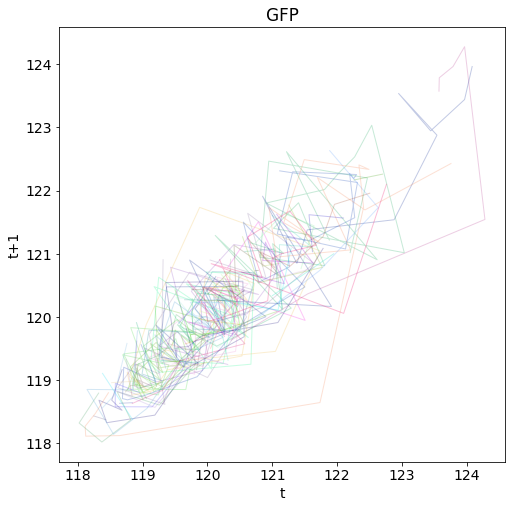

/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/traked_cells/time_series/MGGT-AMP-Pulse_xy01_poincare_DsRed.png


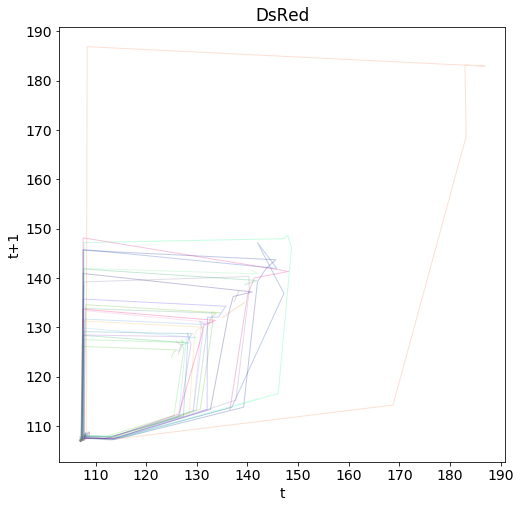

In [66]:
    
mpl.rcParams.update({'font.size': 14})
for i,trap in enumerate(trap_list):
    #print(trap)
    this_lineages=trap_lineages[i]

    data_labels={'GFP','DsRed'}
    for this_data_label in data_labels:
        fileName="%s%s_%s_poincare_%s.png"%(dirNameTimeSeries_Imgs,expeLabel,this_data_label,trap)
        print(fileName)
        plot_cells_poincare(this_lineages, this_data_label, fileName)
        plt.show()    
    

### Horizon Plots

24 22
8
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/traked_cells/time_series/MGGT-AMP-Pulse_xy01_horizons.png


/home/charly/.anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/charly/.anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


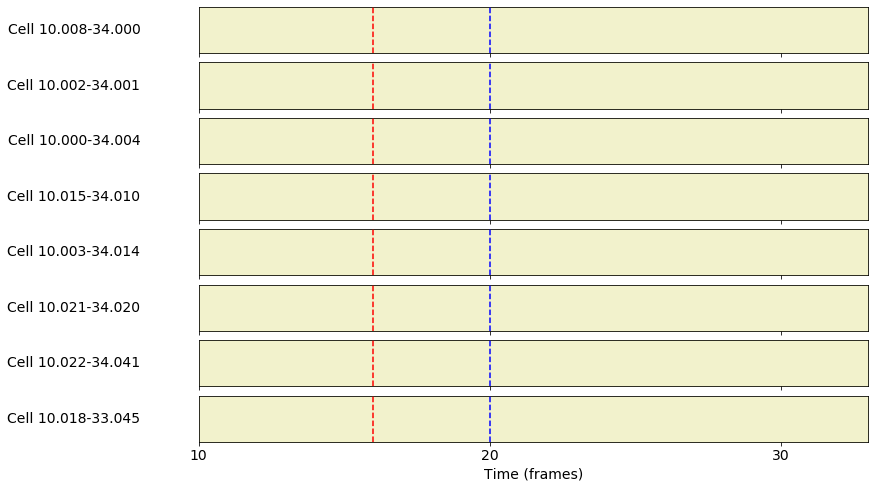

53
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/traked_cells/time_series/MGGT-AMP-Pulse_xy04_horizons.png


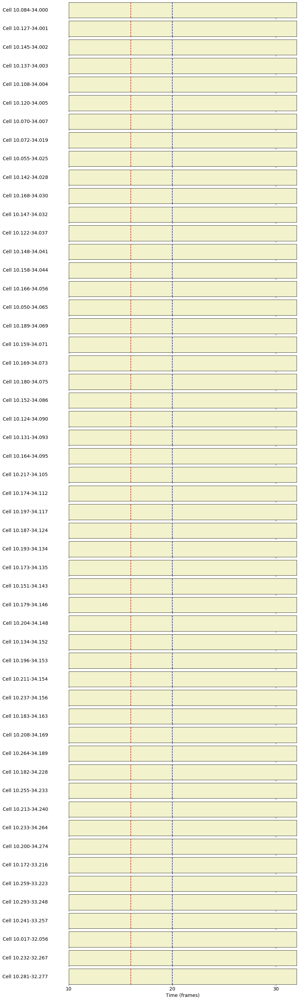

54
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/traked_cells/time_series/MGGT-AMP-Pulse_xy05_horizons.png


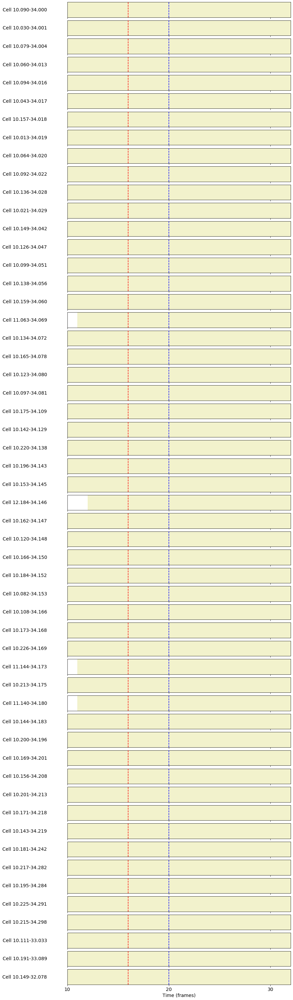

39
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/traked_cells/time_series/MGGT-AMP-Pulse_xy06_horizons.png


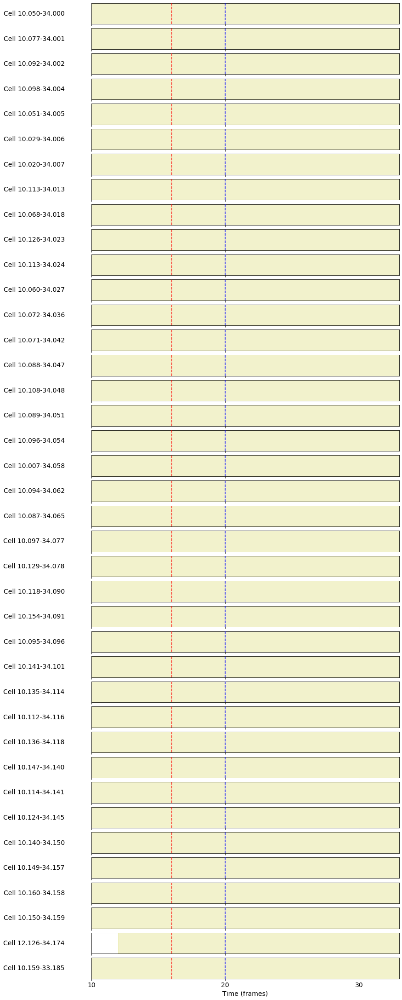

29
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/traked_cells/time_series/MGGT-AMP-Pulse_xy07_horizons.png


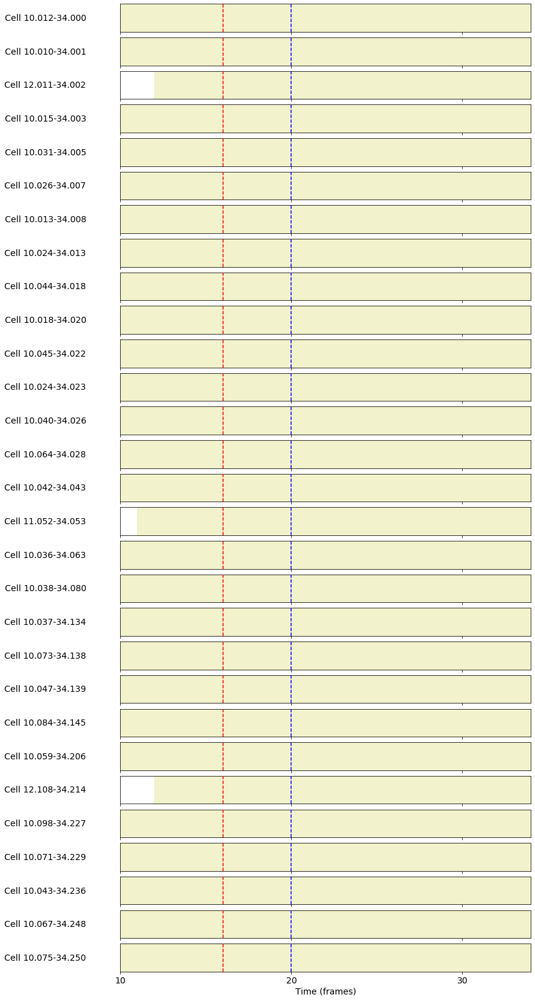

44
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/traked_cells/time_series/MGGT-AMP-Pulse_xy09_horizons.png


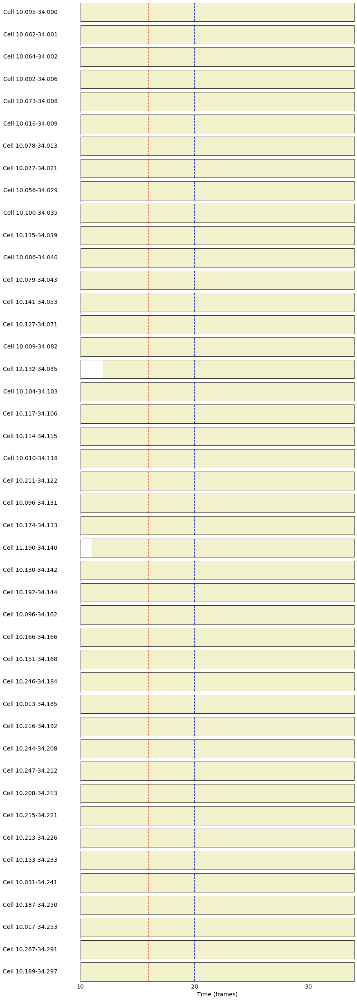

11
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/traked_cells/time_series/MGGT-AMP-Pulse_xy12_horizons.png


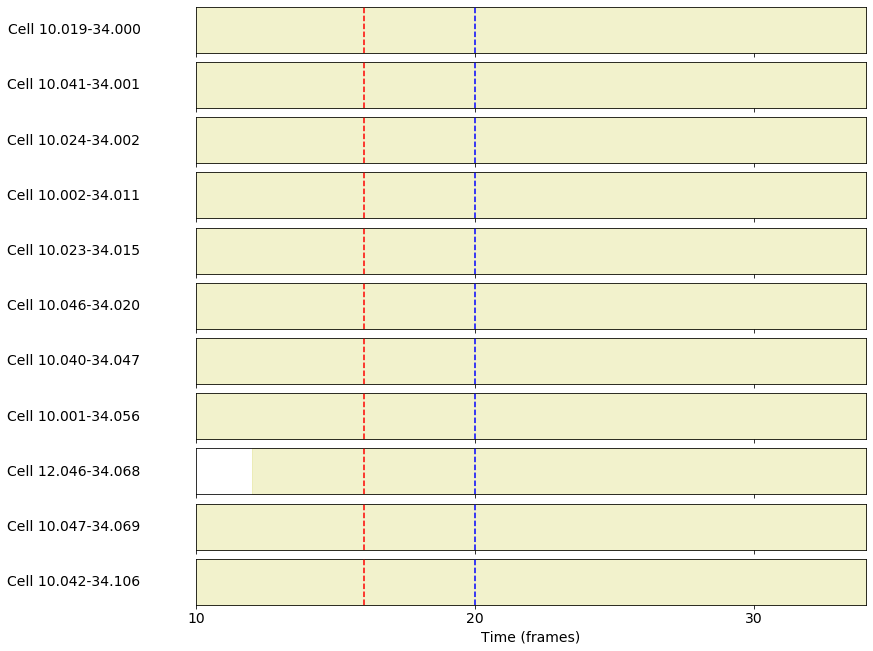

4
/home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/figures/traked_cells/time_series/MGGT-AMP-Pulse_xy13_horizons.png


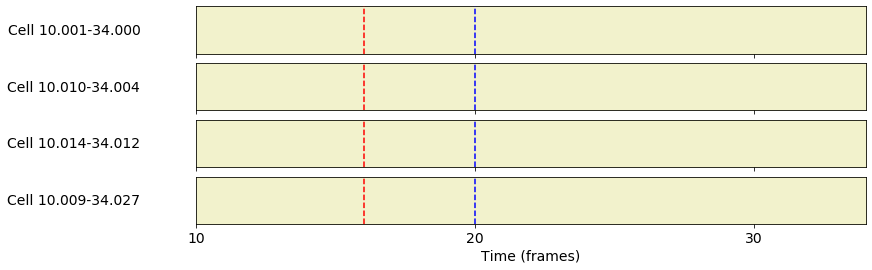

In [103]:


num_levels=1
max_frames=frame_experiment_end-frame_experiment_start
minFrames=max_frames-2

print(max_frames,minFrames)

for i,trap in enumerate(trap_list):
    #print(trap)
    this_lineages=trap_lineages[i]
    
    long_lineages=get_long_lineages(this_lineages, minFrames)
    #long_lineages=get_analysis_lineages(this_lineages, frame_signal_start,frame_experiment_end,frame_experiment_start)
    #long_lineages=long_lineages[0:5]
    print(len(long_lineages))
    fileName="%s%s_horizons_%s.png"%(dirNameTimeSeries_Imgs,expeLabel,trap)
    print(fileName)
    plot_NormGFP_Horizon(long_lineages, num_levels, fileName,frame_signal_start,frame_signal_end,frame_experiment_start)
    plt.show()
    plt.close()   

## Load Data & Plot layer

In [12]:
trap_df_lineages_all=[]
trap_df_lineages_analysis=[]
for i,trap in enumerate(trap_list):
    cell_lineages=trap_lineages[i]
    dirNameDATALINEAGES=rootDir+'data/lineages/'
    lineagesDataFile='%s%s_%s_lineages_analysis.csv'%(dirNameDATALINEAGES, expeLabel, trap)
    df_lineages=load_data_lineages(lineagesDataFile)
    trap_df_lineages_analysis.append(df_lineages)
    list_frames_analysis=df_lineages.frame.unique()
    lineagesDataFile='%s%s_%s_lineages_all.csv'%(dirNameDATALINEAGES, expeLabel, trap)
    df_lineages=load_data_lineages(lineagesDataFile)
    trap_df_lineages_all.append(df_lineages)
    list_frames_all=df_lineages.frame.unique()

Loading 21 lineages from /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy01_lineages_analysis.csv
Loading 155 lineages from /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy01_lineages_all.csv
Loading 148 lineages from /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy04_lineages_analysis.csv
Loading 1217 lineages from /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy04_lineages_all.csv
Loading 185 lineages from /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy05_lineages_analysis.csv
Loading 1372 lineages from /home/charly/Lab/Projects/uJ/uJ_data/MGGT-AMP-Pulse/20190828_Bruno_MGGT_quimiostato/data/lineages/MGGT-AMP-Pulse_xy05_lineages_all.csv
Loading 104 lineag

### Draw ROIs + Data Overlay (export to PNG)  

In [14]:
for i,trap in enumerate(trap_list):
    #cell_lineages=trap_lineages[i]
    df_lineages=trap_df_lineages_all[i]
    print(df_lineages.GFP.mean(),df_lineages.GFP.min(),df_lineages.GFP.max(),"\t",df_lineages.DsRed.mean(),df_lineages.DsRed.min(),df_lineages.DsRed.max())
    

120.10957696693276 118.02 124.279 	 111.73199429874568 106.764 186.868
131.73976153189076 119.16 179.85 	 112.99511076309801 106.225 182.482
127.65717914012724 118.223 187.899 	 113.61671443736724 106.233 186.814
123.63454583683796 117.796 151.124 	 114.51027039529016 106.128 203.094
124.19336784330604 117.846 158.425 	 111.81975139905306 105.96 177.704
120.03536828329463 116.853 124.56 	 111.57513672055453 106.18 187.677
119.19667418546369 117.073 122.88 	 110.55399749373443 106.299 198.822
118.64819169960457 116.333 121.886 	 110.25520948616597 106.375 191.942


116.333 187.899
105.96 203.094
33436


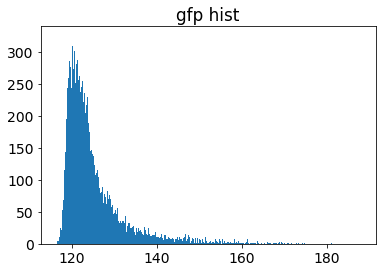

33436


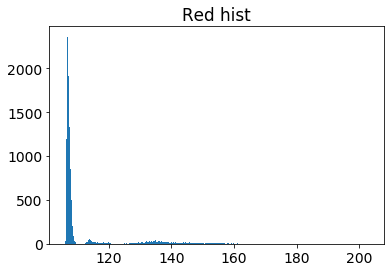

In [16]:
all_df_lineages=pd.concat(trap_df_lineages_all)
maxg=all_df_lineages["GFP"].max()
ming=all_df_lineages["GFP"].min()
maxr=all_df_lineages["DsRed"].max()
minr=all_df_lineages["DsRed"].min()
print(ming,maxg)
print(minr,maxr)
gb=np.linspace(float(ming),float(maxg),1000)
#gs=[float(x) for x in all_df_lineages["GFP"]]
gs=list(all_df_lineages["GFP"])
print(len(gs))
plt.hist(gs,bins=gb)
plt.title("gfp hist")
plt.show()
rb=np.linspace(float(minr),float(maxr),1000)
rs=list(all_df_lineages["DsRed"])
print(len(rs))
plt.hist(rs,bins=rb)
plt.title("Red hist")
plt.show()



In [107]:
layer1 = {'channel':'GFP',  'minvalue':110, 'maxvalue':160, 'contour':True}
layer2 = {'channel':'DsRed','minvalue':100,'maxvalue':160,'contour':True}
layer3 = {'channel':'Mask','minvalue':100,'maxvalue':500,'contour':True}
#layer4 = {'channel':'death','minvalue':0,'maxvalue':1,'contour':True}
layer5 = {'channel':'Tracking','minvalue':0,'maxvalue':0,'contour':True}
layer6 = {'channel':'division','minvalue':0,'maxvalue':1,'contour':True}
layers=[layer1, layer2, layer3, layer4, layer5, layer6]
layers=[layer1, layer2, layer3, layer5,layer6]
#layers=[layer5]
trap_df_lineages=trap_df_lineages_analysis
for i,trap in enumerate(trap_list):
    cell_lineages=trap_lineages[i]
    df_lineages=trap_df_lineages[i]
    dirNameTRACKEDCELLS_IMGS=rootDir+'figures/traked_cells/'+trap+'/'
    print(trap)
    for layer in layers:
        print("Exporting layer %s"%(layer['channel']))
        dirNameIMAGEOVERLAY=dirNameTRACKEDCELLS_IMGS+layer['channel']+'/'
        if not os.path.exists(dirNameIMAGEOVERLAY):
            os.makedirs(dirNameIMAGEOVERLAY)

        for this_frame in frames_list:
            [trackIDs, trackPolys, trackData]=get_data_roi(cell_lineages, df_lineages, this_frame,layer['channel'])
            #print(trackIDs, trackPolys, trackData)
           
            fileNameIMAGEOVERLAY="%s/%s_%s_%s.png"%(dirNameIMAGEOVERLAY,expeLabel,trap,str(this_frame).zfill(3))

            draw_channel(this_frame, layer, trackIDs, trackPolys, trackData, fileNameIMAGEOVERLAY,flims)
            

xy01
Exporting layer GFP
Exporting layer DsRed
Exporting layer Mask
Exporting layer Tracking
Exporting layer division
xy04
Exporting layer GFP
Exporting layer DsRed
Exporting layer Mask
Exporting layer Tracking
Exporting layer division
xy05
Exporting layer GFP
Exporting layer DsRed
Exporting layer Mask
Exporting layer Tracking
Exporting layer division
xy06
Exporting layer GFP
Exporting layer DsRed
Exporting layer Mask
Exporting layer Tracking
Exporting layer division
xy07
Exporting layer GFP
Exporting layer DsRed
Exporting layer Mask
Exporting layer Tracking
Exporting layer division
xy09
Exporting layer GFP
Exporting layer DsRed
Exporting layer Mask
Exporting layer Tracking
Exporting layer division
xy12
Exporting layer GFP
Exporting layer DsRed
Exporting layer Mask
Exporting layer Tracking
Exporting layer division
xy13
Exporting layer GFP
Exporting layer DsRed
Exporting layer Mask
Exporting layer Tracking
Exporting layer division


### Plot tracks GFP

xy01


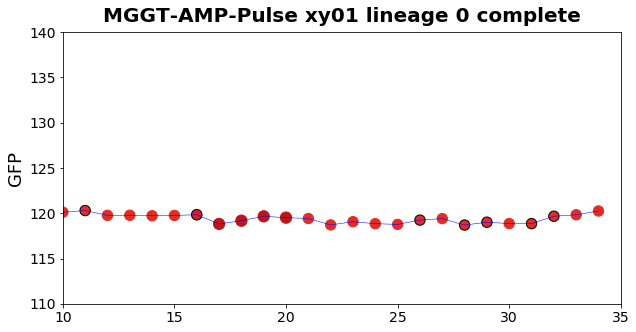

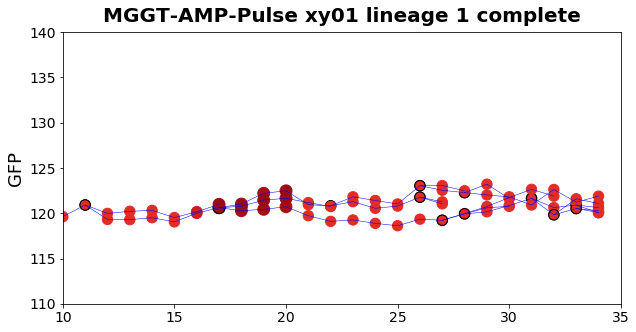

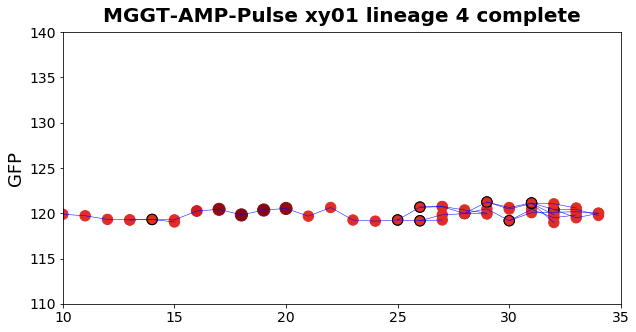

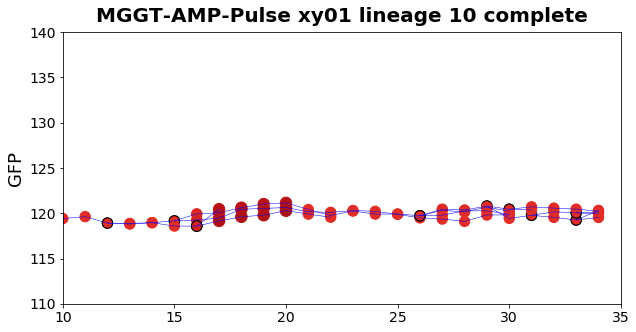

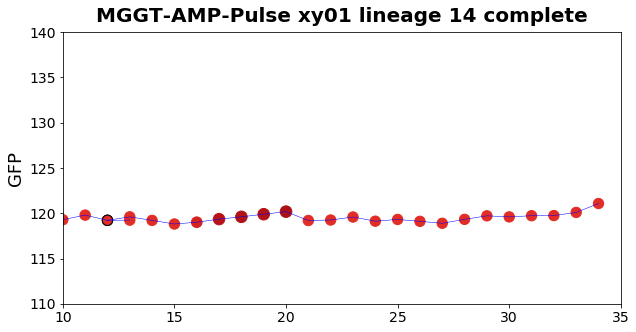

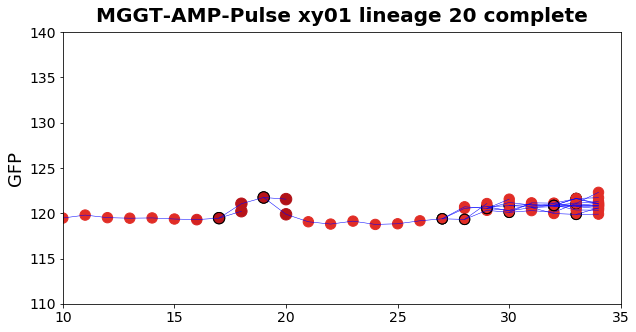

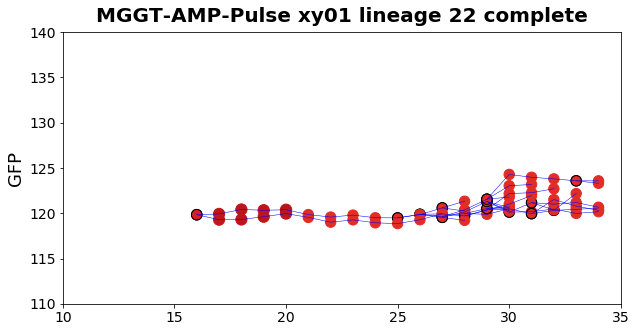

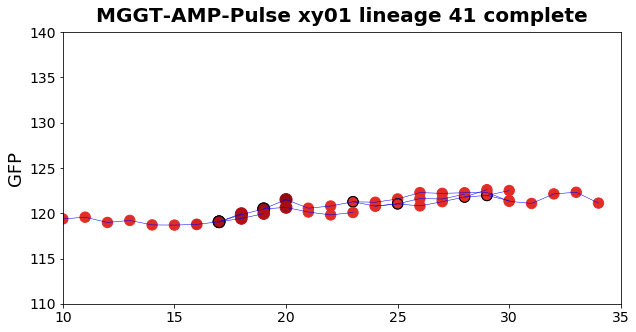

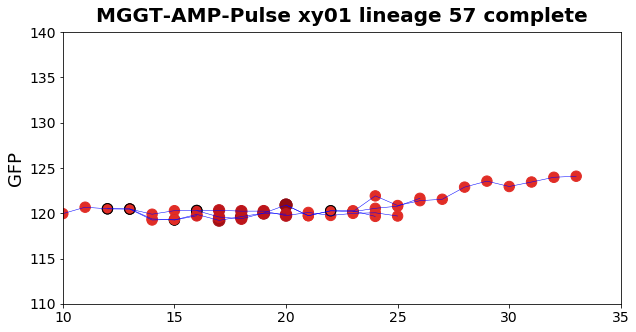

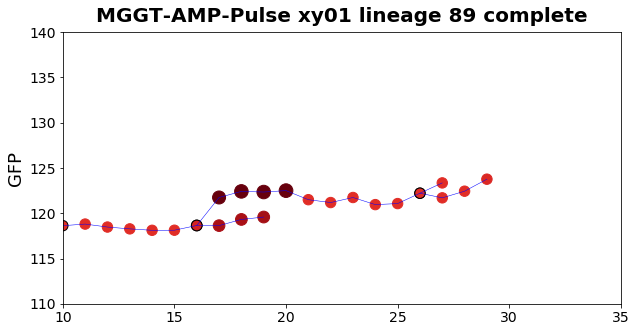

xy04


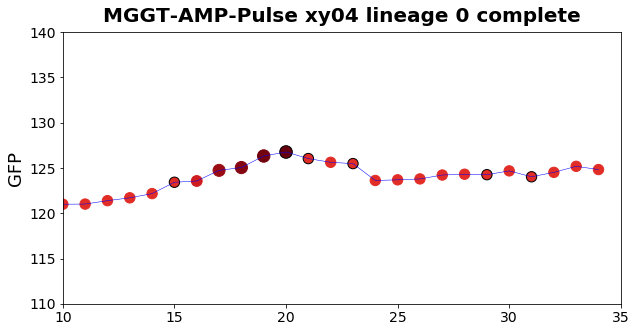

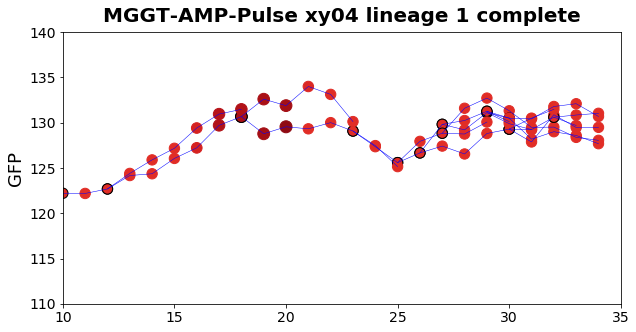

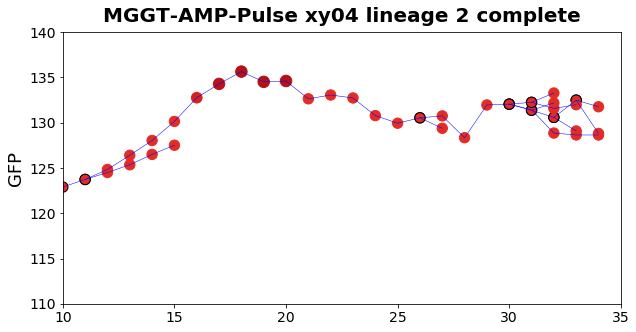

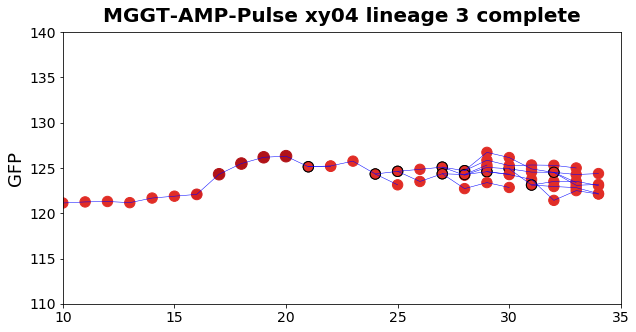

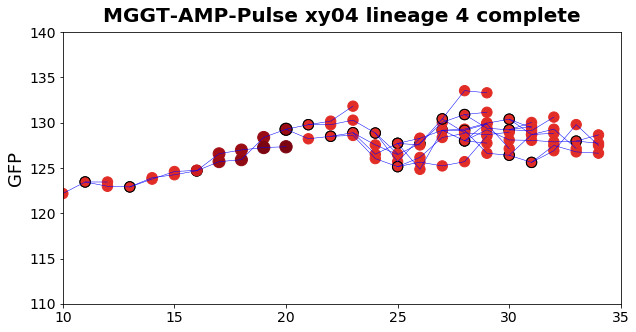

...

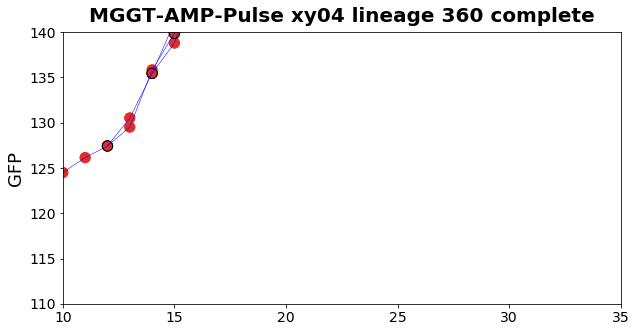

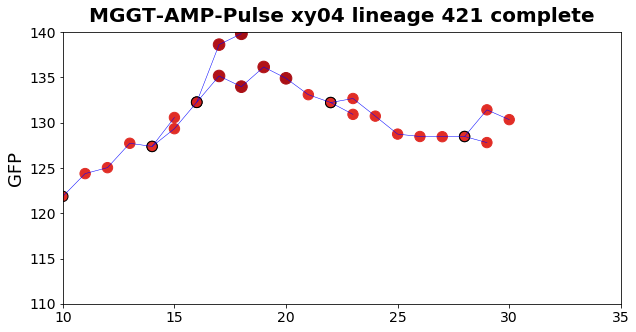

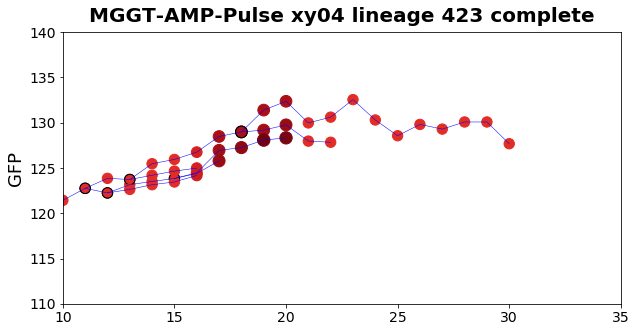

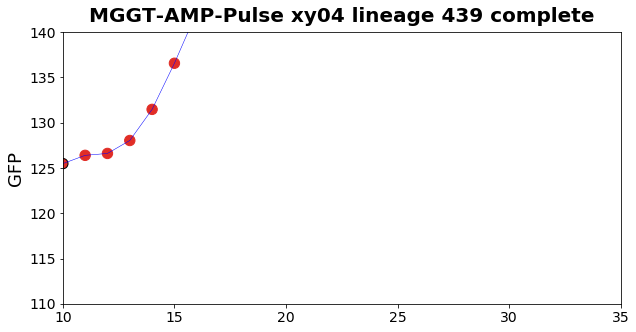

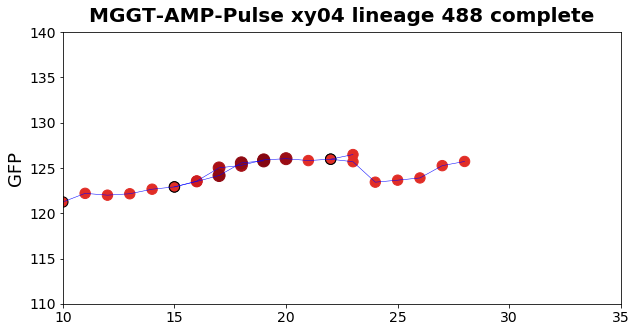

xy05


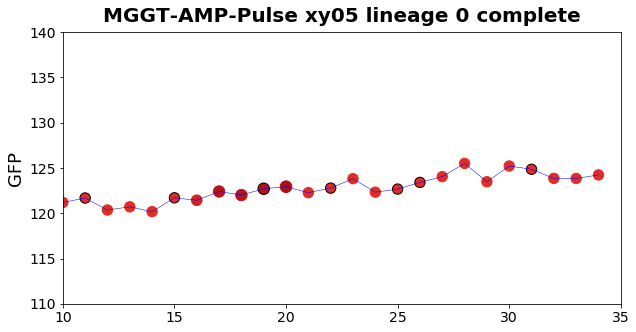

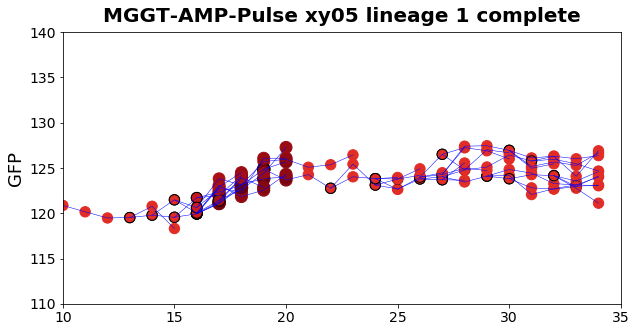

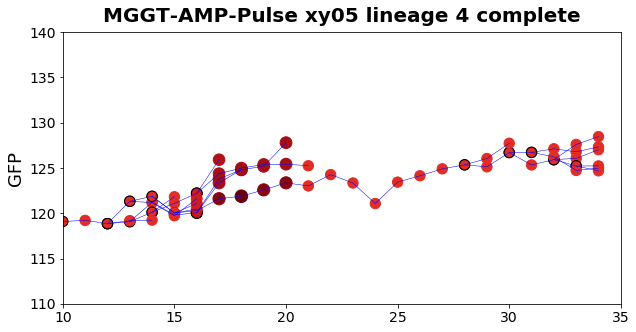

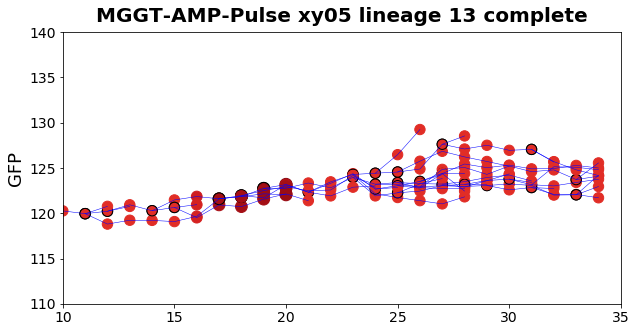

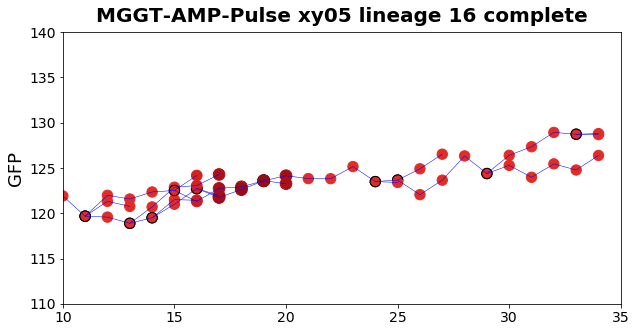

...

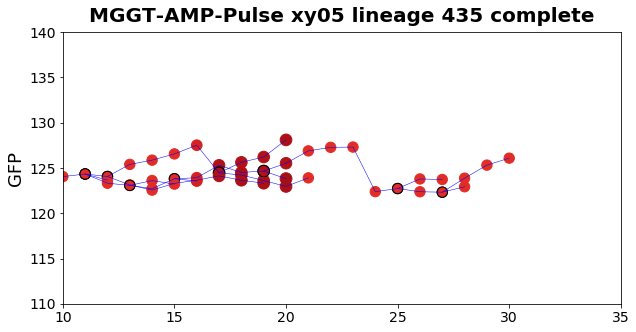

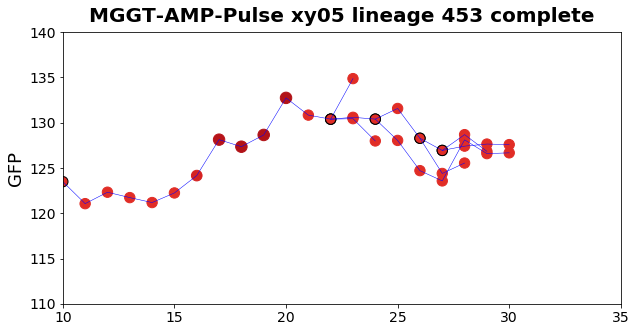

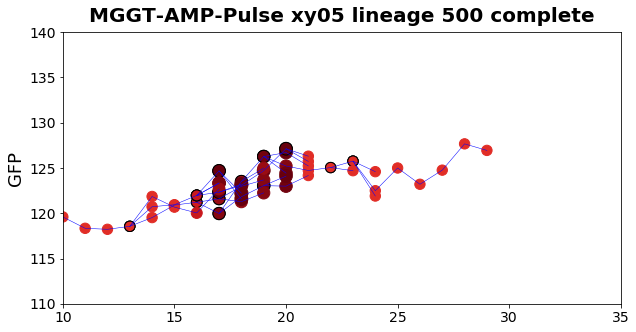

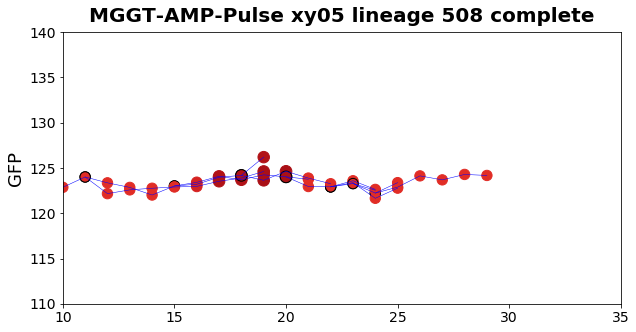

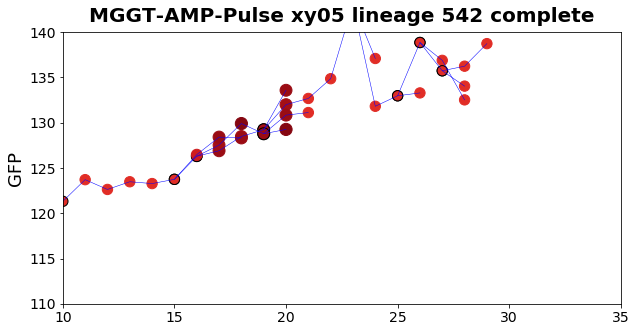

xy06


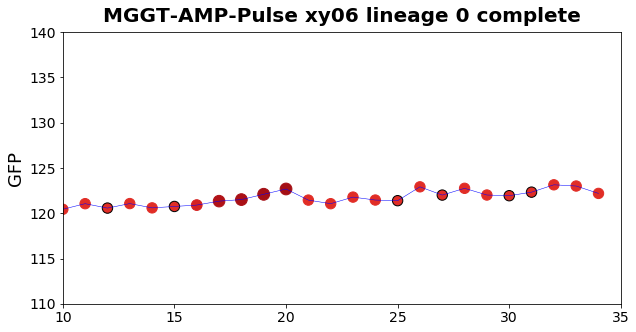

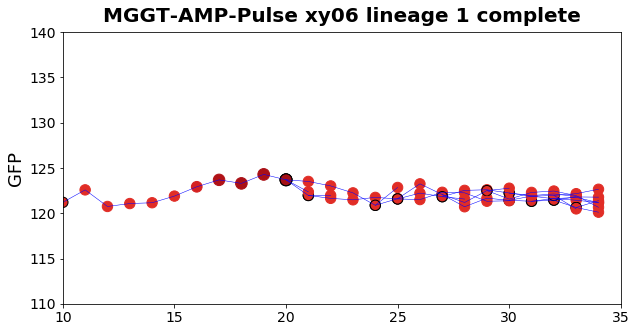

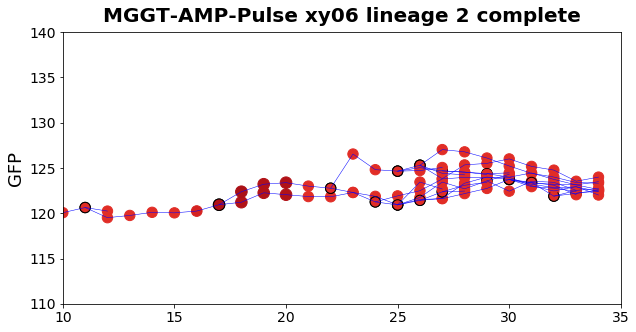

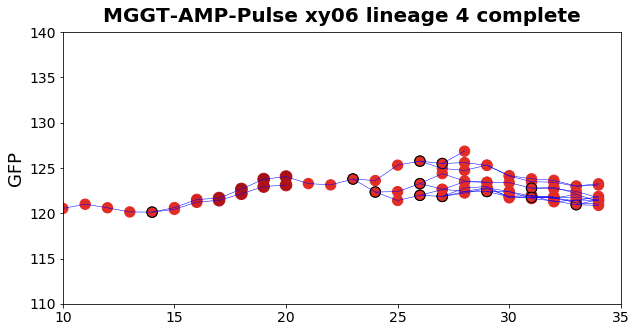

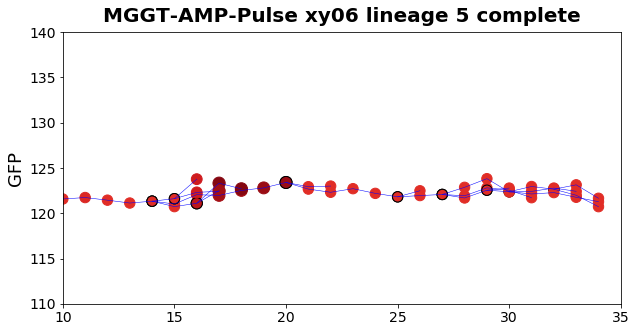

...

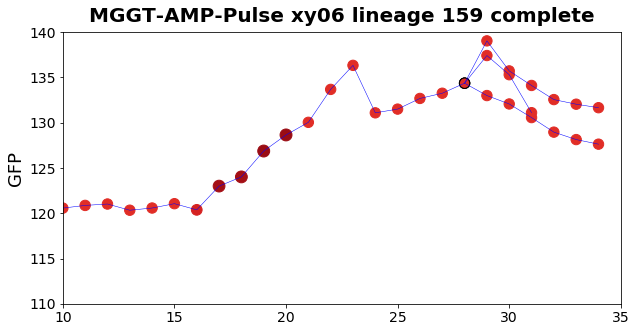

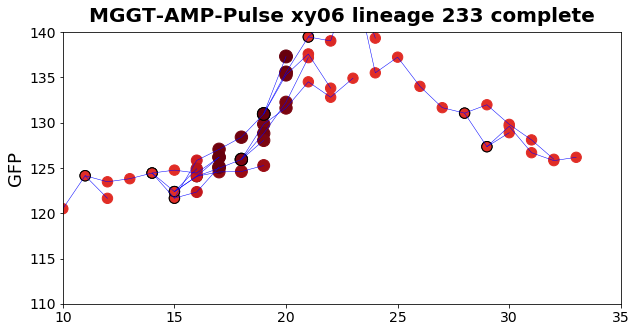

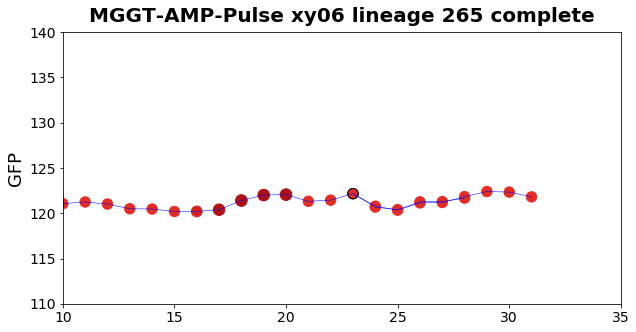

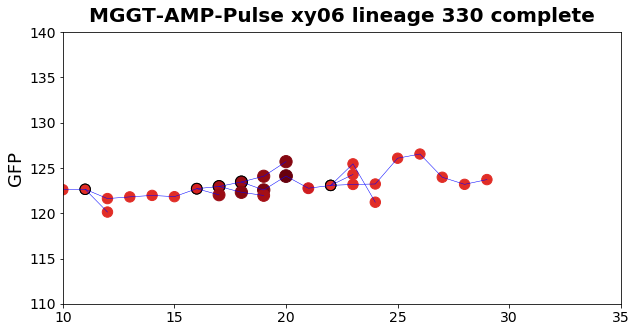

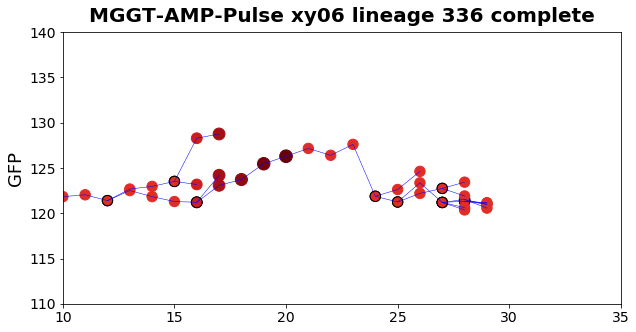

xy07


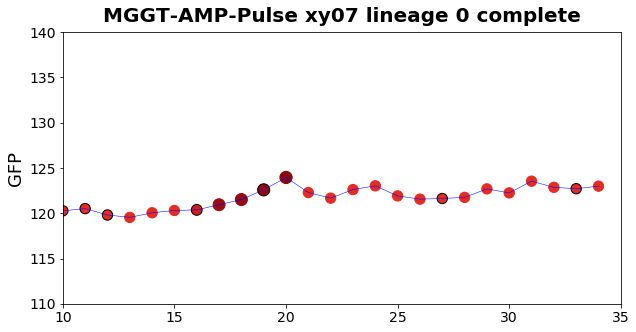

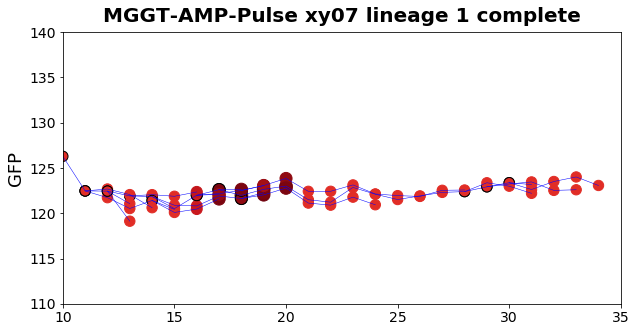

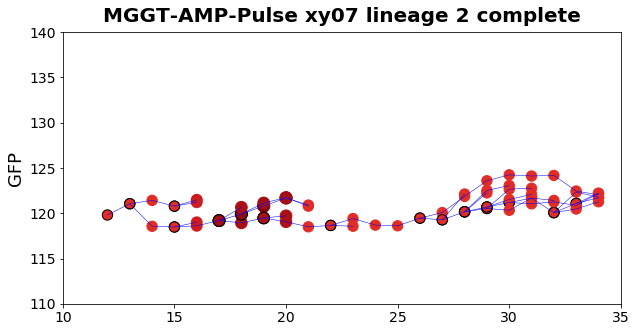

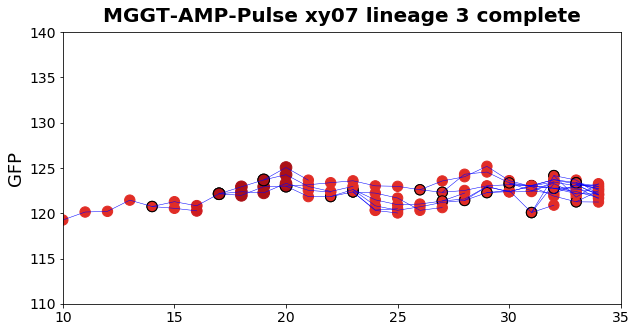

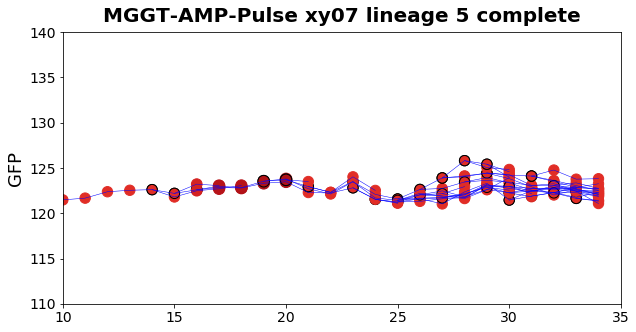

...

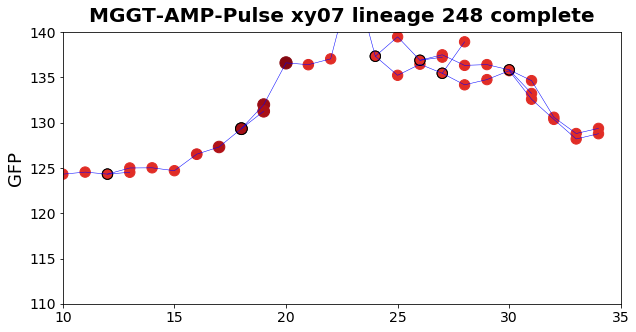

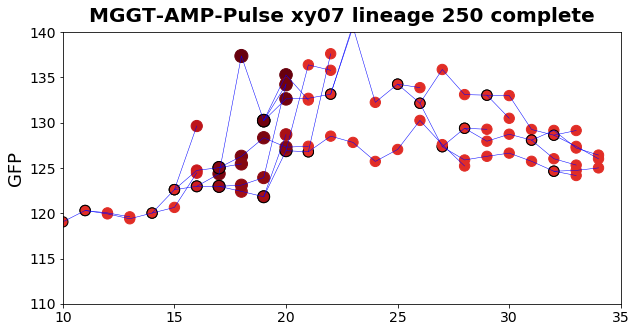

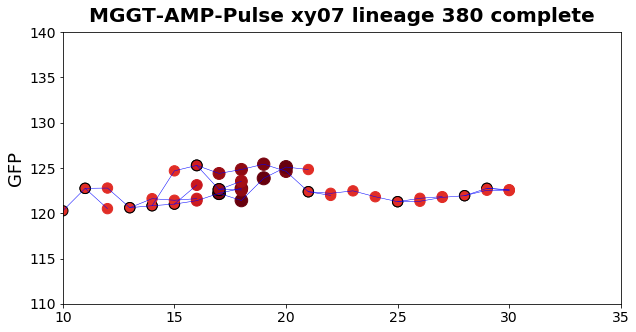

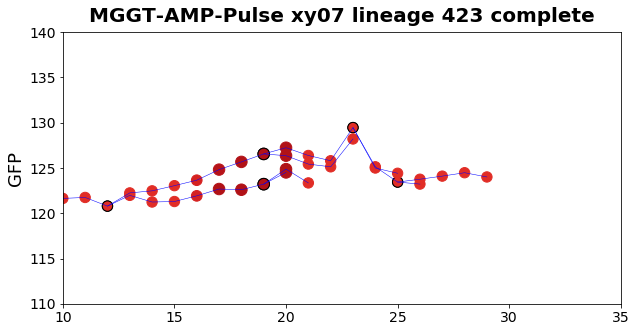

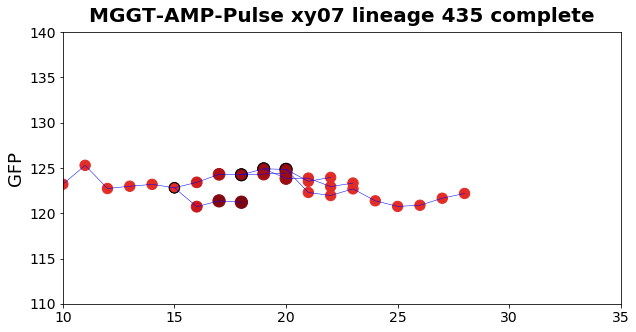

xy09


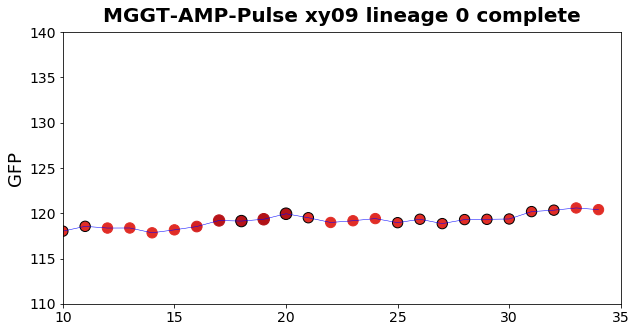

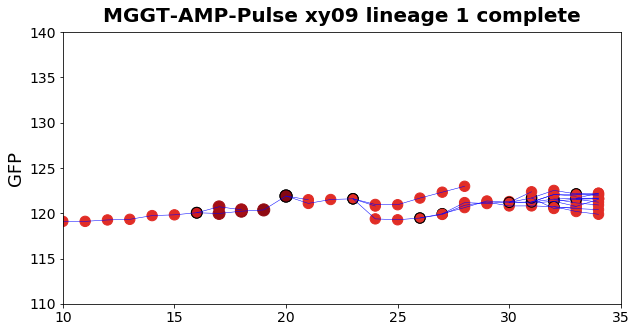

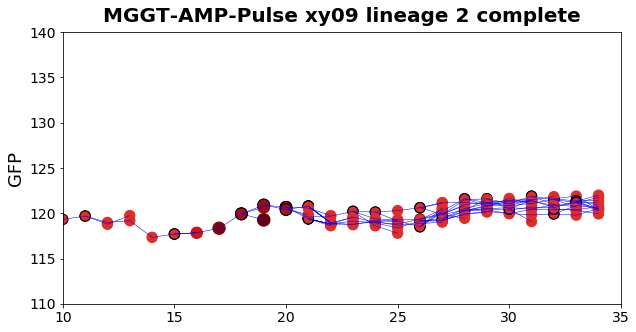

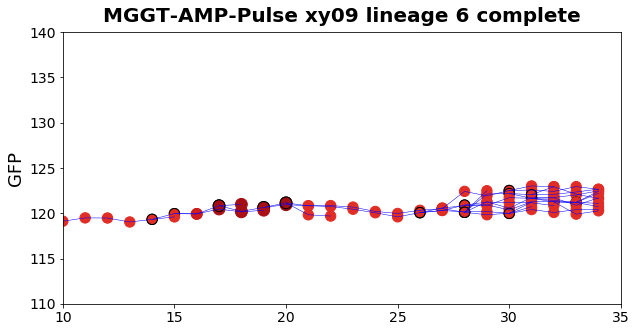

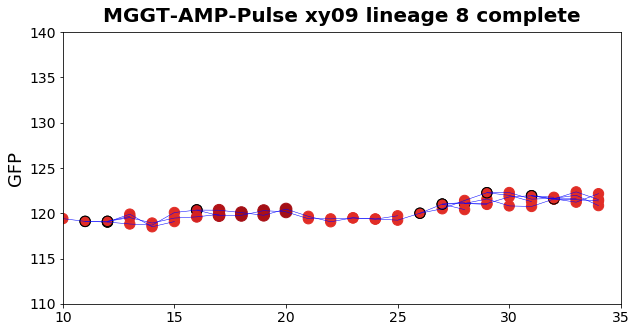

...

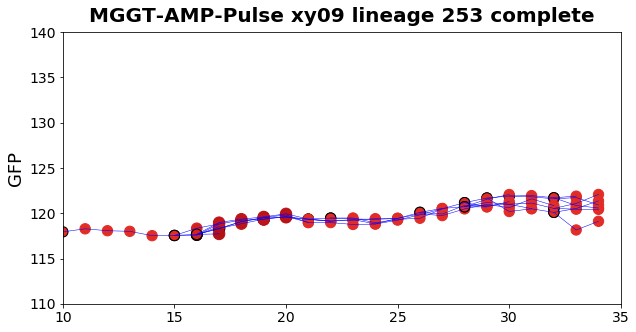

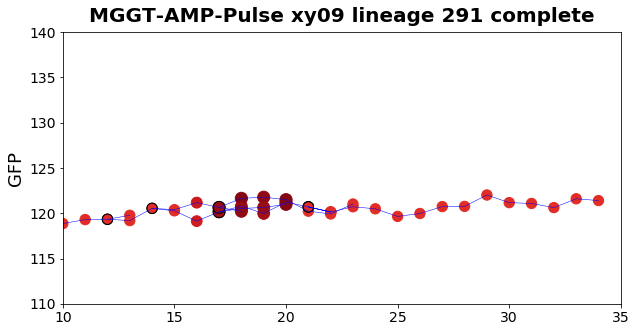

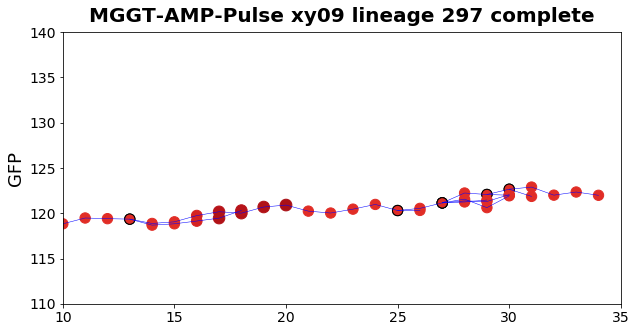

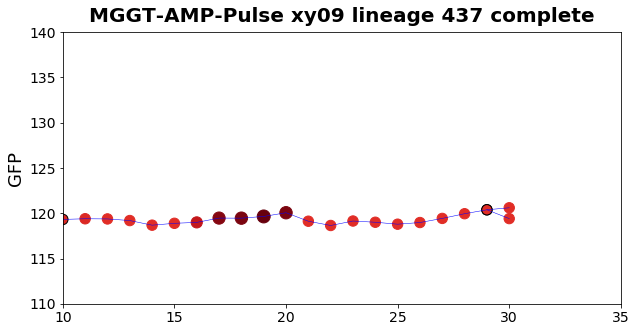

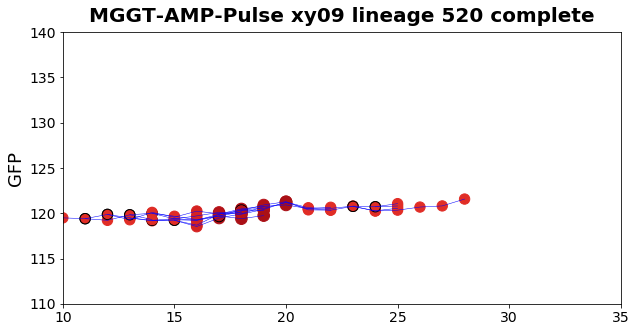

xy12


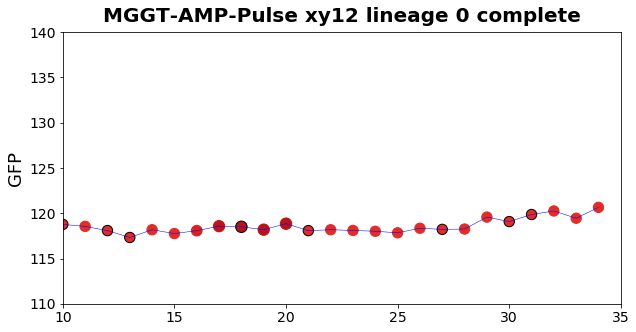

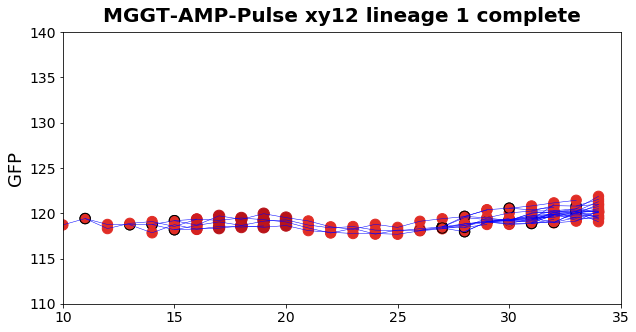

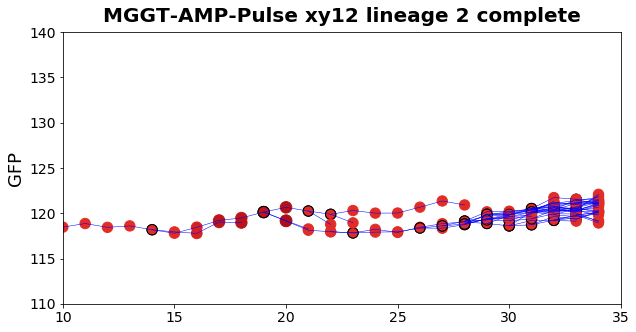

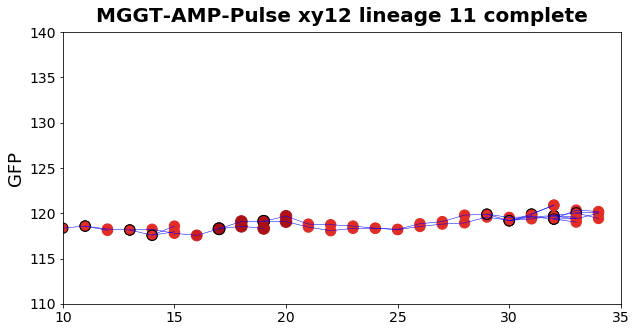

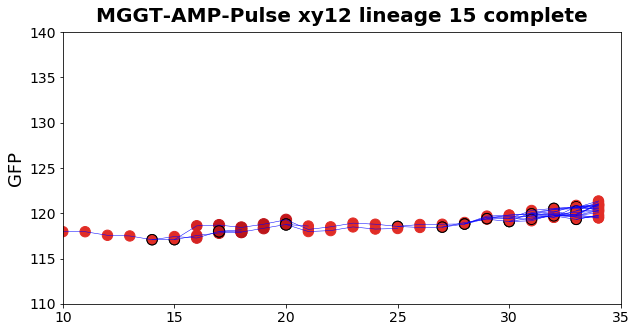

...

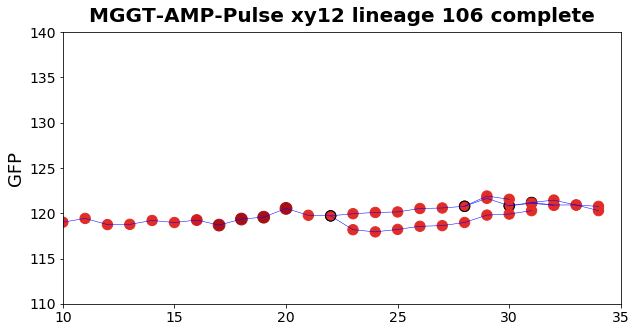

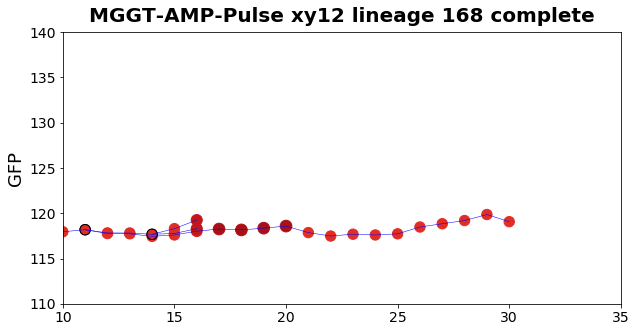

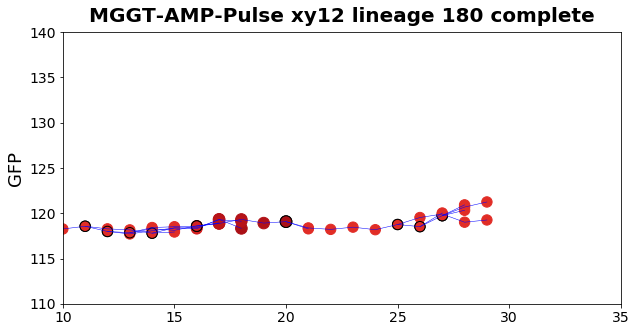

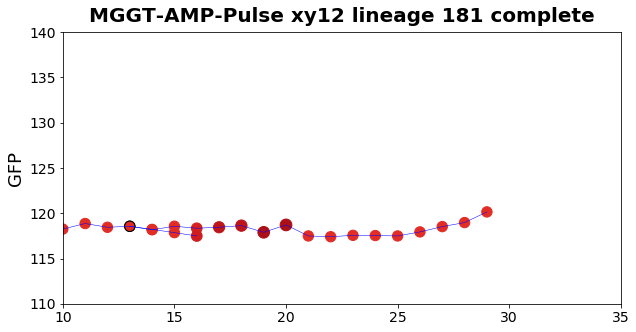

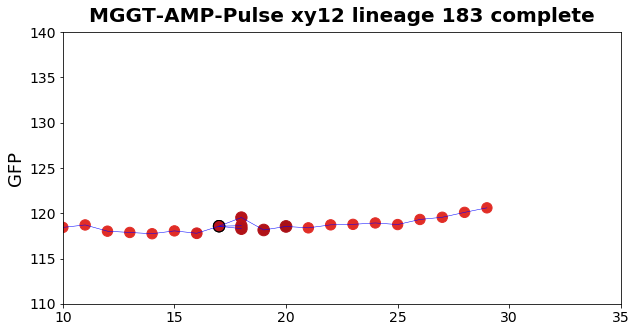

xy13


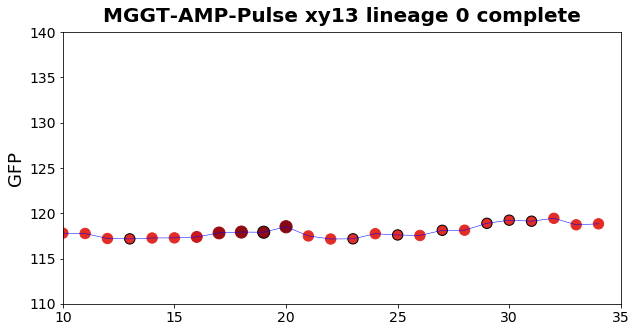

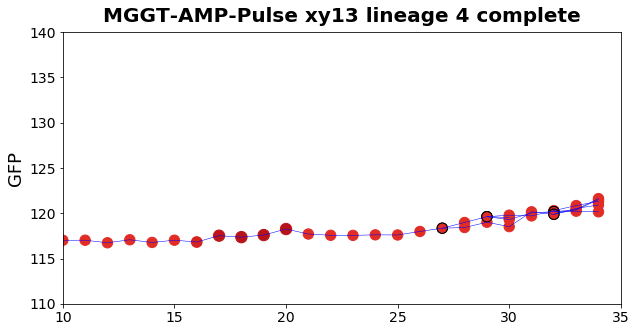

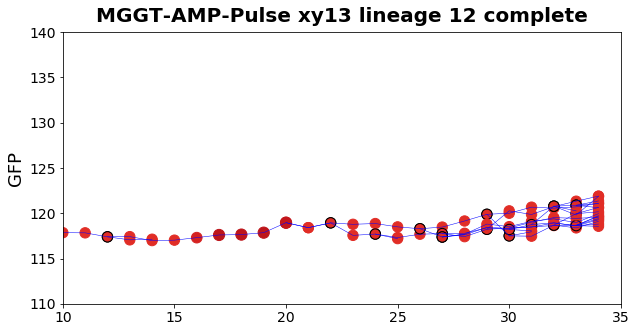

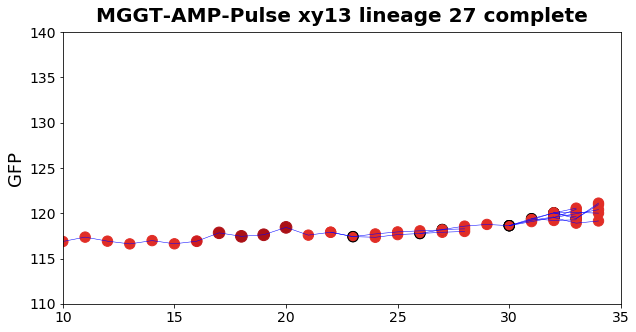

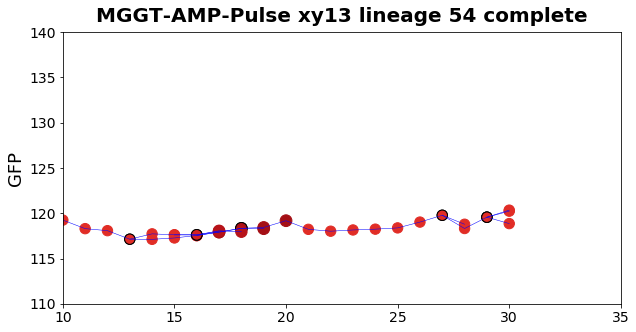

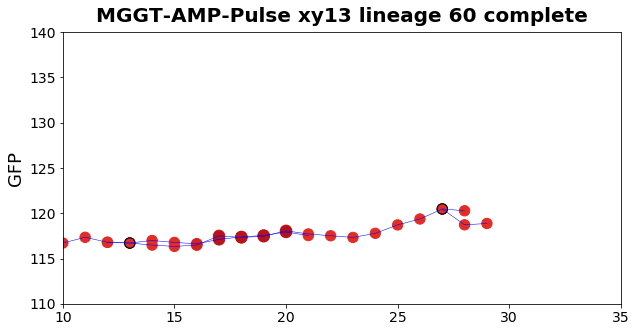

In [141]:
ncolors=50
cmap = cm.get_cmap("Reds", ncolors)
maxred=160
def plot_fancy_tracks(ax,this_df,alphs,alphp):
    
    gfps=list(this_df["GFP"])
    reds=list(this_df["DsRed"])
    frames=list(this_df["frame"])
    divs=list(this_df["division"])
    
    ss=[x for x in reds]
    #  meanPhi_Nrot,maxRho_N,meanRho_N  
    colors=cmap([x/maxred for x in reds])
    ecolors=colors.copy()
    for ic,div in enumerate(divs):
        if div==1:
            ecolors[ic]=(0.0, 0.0, 0.0, 1.0)
    
    
    
    if(alphs==1):
        ax.scatter(frames,gfps,s=ss,c=colors,alpha=alphs,edgecolors=ecolors,zorder=2)
        ax.plot(frames, gfps,c='b',linewidth=.5,alpha=alphp,zorder=2)
    else:
        ax.scatter(frames,gfps,s=ss,c=colors,alpha=alphs)
        ax.plot(frames, gfps,c='k',linewidth=.85,alpha=alphp)

    return ax

minFramesThr=frame_experiment_end-frame_experiment_start-5
trap_df_lineages=trap_df_lineages_all
list_frames=list_frames_all
for i,trap in enumerate(trap_list):
    dir_images=rootDir+'figures/lineages/complete_lineages/'+trap+"/"
    if not os.path.exists(dir_images):
        os.makedirs(dir_images)

    
    df_lineages=trap_df_lineages[i]
    print(trap)

    for linID in df_lineages.lineageID.unique():

        this_ldf=df_lineages[df_lineages["lineageID"]==linID]
        frames=this_ldf.frame.unique()
        nframes=len(frames)
        if(nframes<minFramesThr):
            continue
        fig= plt.figure( figsize=(10, 5))
        ax=plt.subplot()
        longest_track=""
        maxFrames=0
        for trackID in this_ldf.trackID.unique():
            this_tdf=this_ldf[this_ldf["trackID"]==trackID]
            frames=this_tdf.frame.unique()
            nframes=len(frames)
            if maxFrames<nframes: 
                maxFrames=nframes
                longest_track=trackID

        for trackID in this_ldf.trackID.unique():
            #alphs=.1
            #alphp=.25
            alphs=1
            alphp=1
            if trackID==longest_track:
                alphs=1
                alphp=1

            this_tdf=this_ldf[this_ldf["trackID"]==trackID]
            ax=plot_fancy_tracks(ax,this_tdf,alphs,alphp)
       # yt=np.linspace(0,3,7)
            #print(yt)
        #ax.set_yticks(yt)
        #yts1=ax.get_yticklabels()
        
        #ytl=[str(y) for y in yts1]
        #ytc=cmap([1-y/np.pi for y in yt])
        
#         for ticklabel, tickcolor in zip(yts1, ytc):
#             ticklabel.set_color(tickcolor)
#             ticklabel.set_fontsize(18)
        ax.set_ylabel("GFP",fontsize=18)
        
        ax.set_xlim(xmin=list_frames[0],xmax=list_frames[-1]+1)
        ax.set_ylim(ymin=110,ymax=140)
        ax.set_title("%s %s lineage %s complete"%(expeLabel,trap,linID), va='bottom',fontweight='bold',fontsize=20)
        figName="%s%s_%s_lineage-%s_complete.png"%(dir_images,expeLabel,trap,linID)
        plt.savefig(figName)
        plt.show()

### Plot tracks Red

xy01


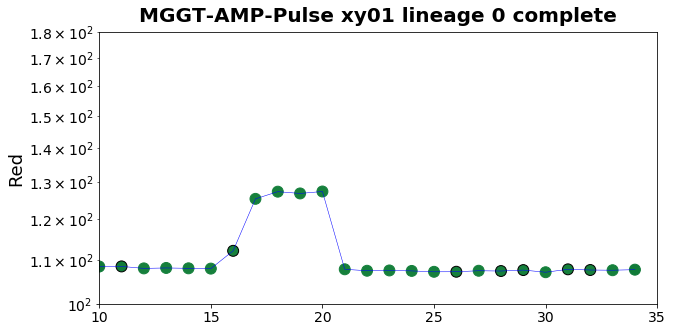

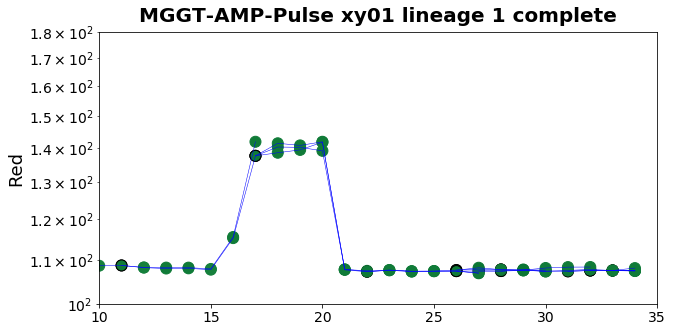

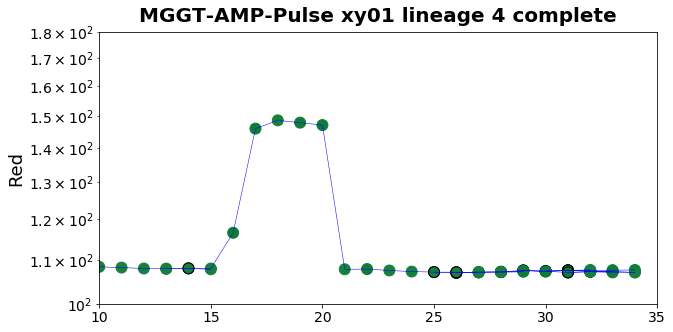

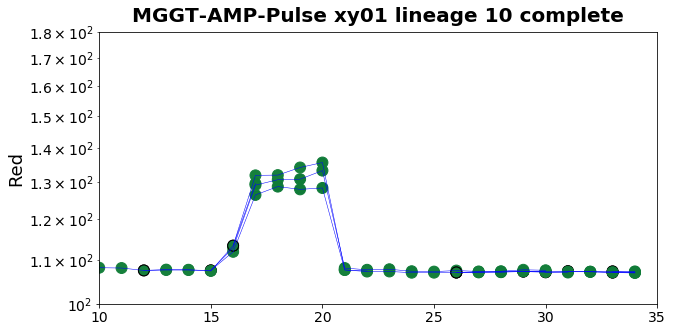

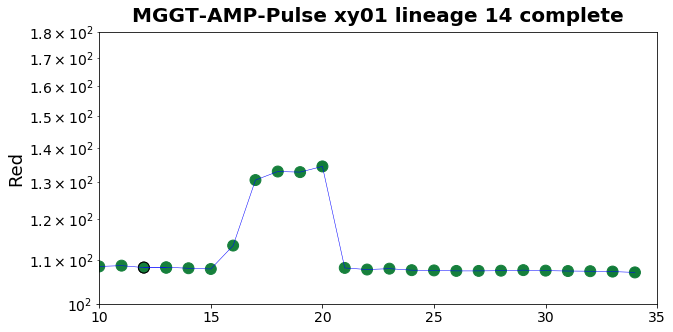

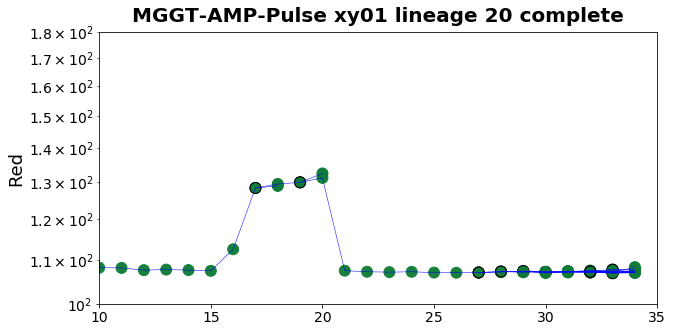

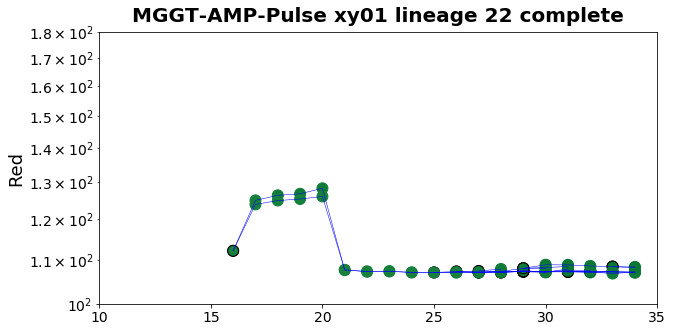

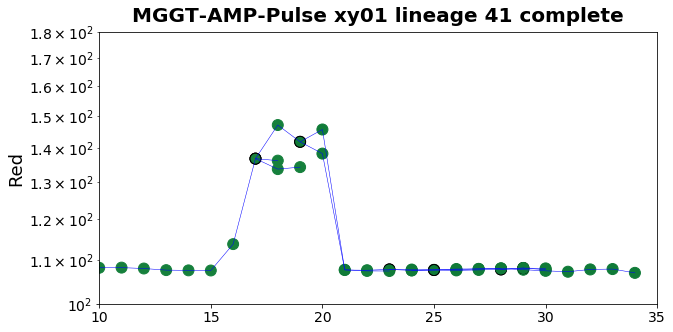

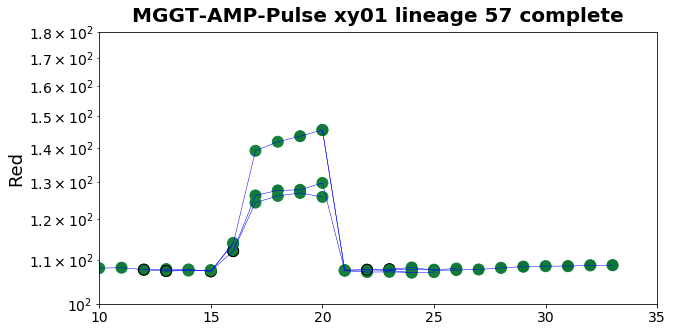

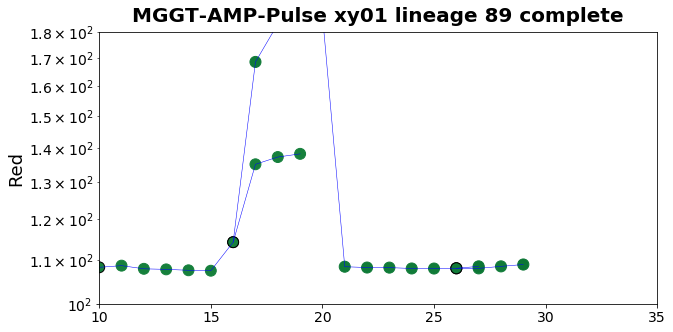

xy04


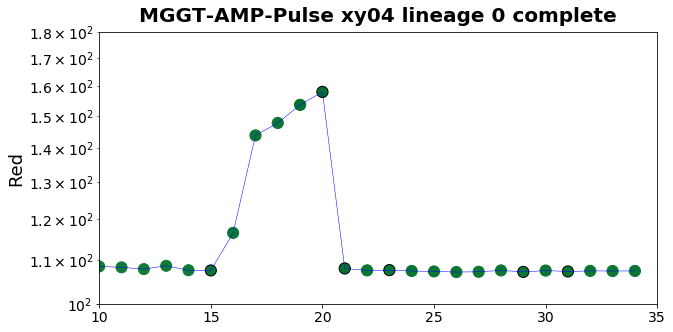

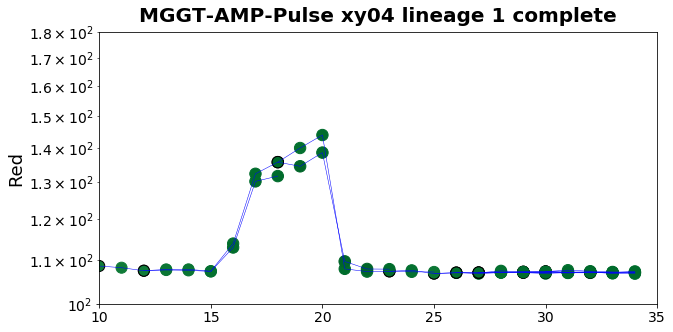

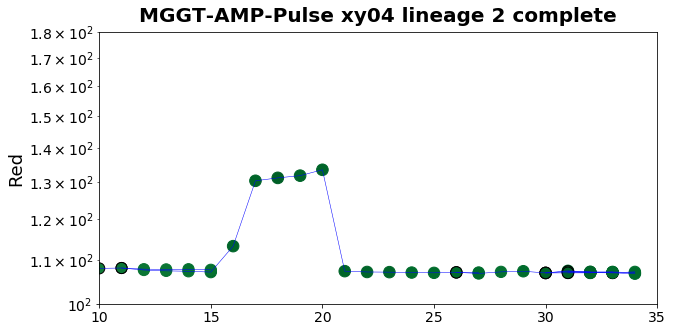

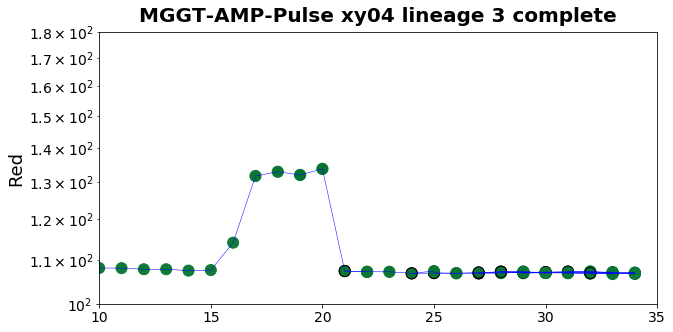

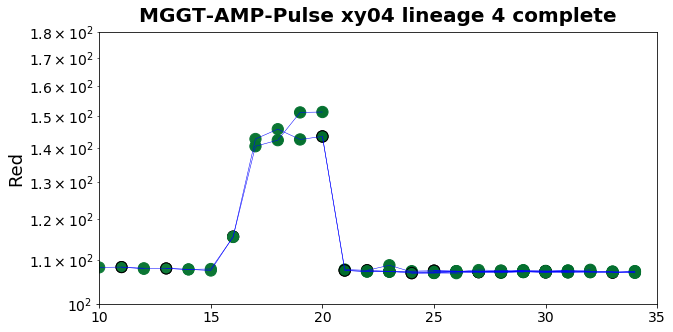

...

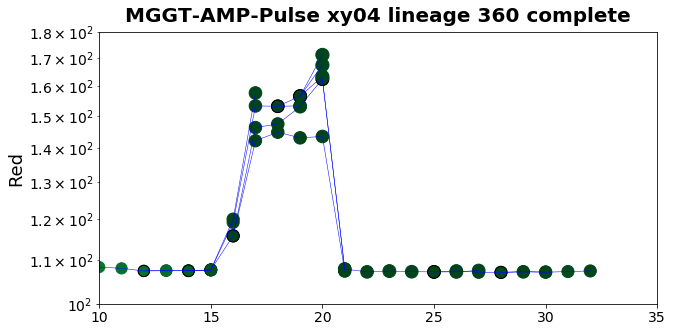

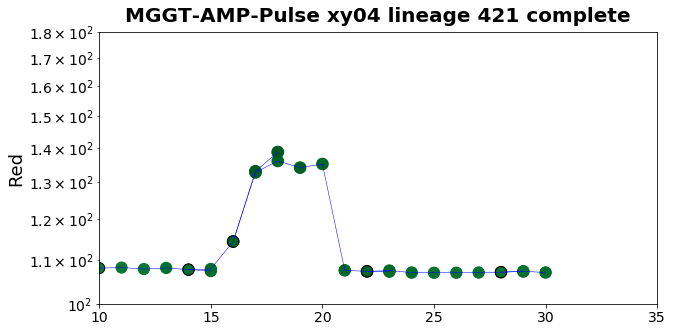

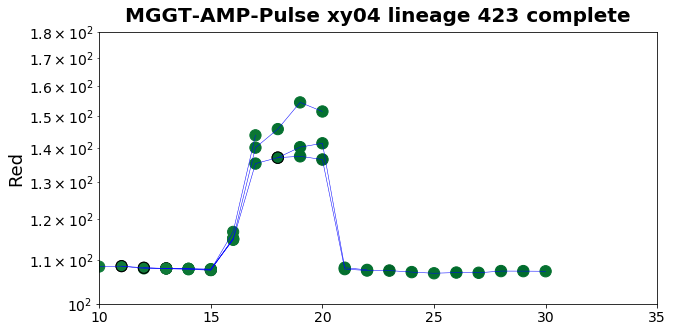

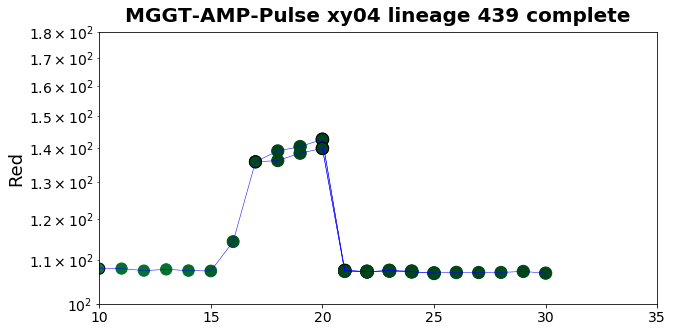

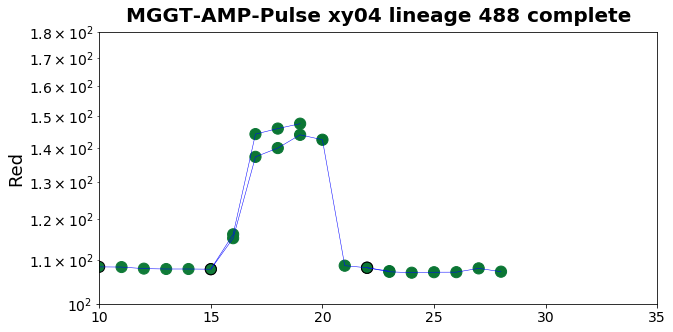

xy05


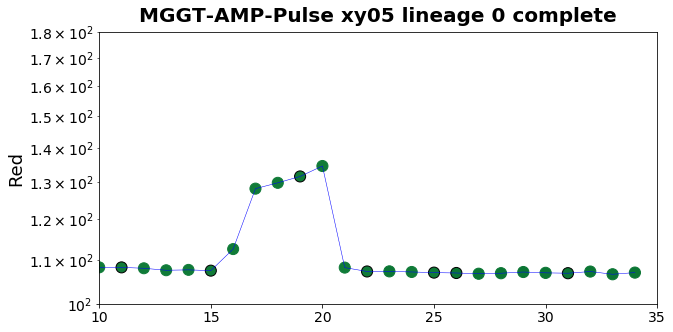

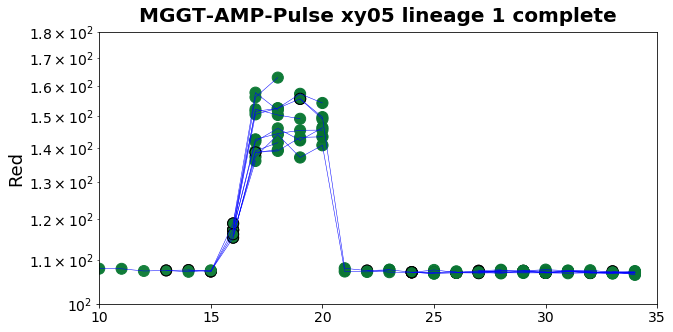

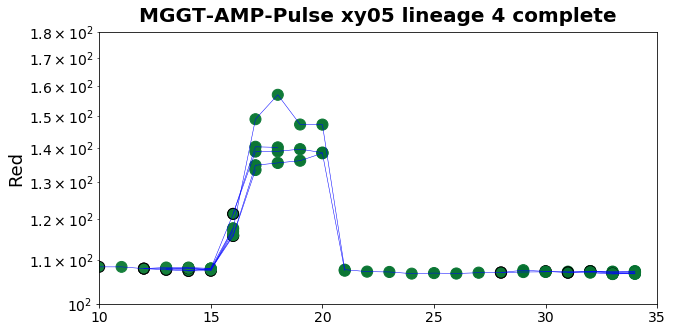

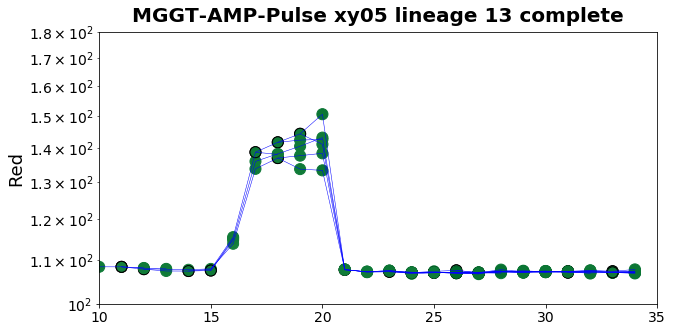

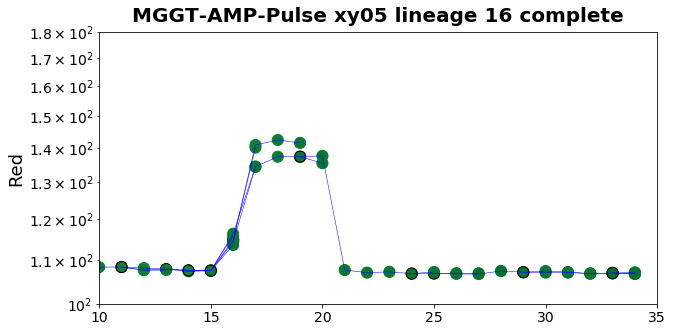

...

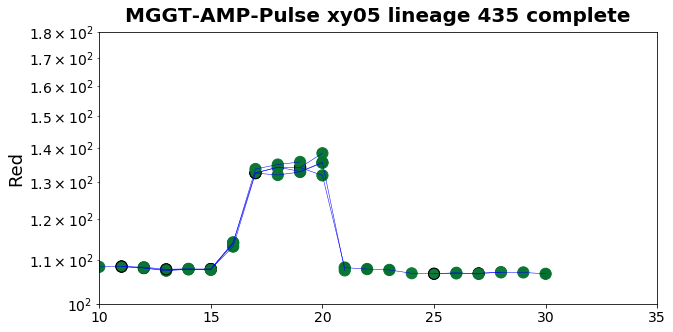

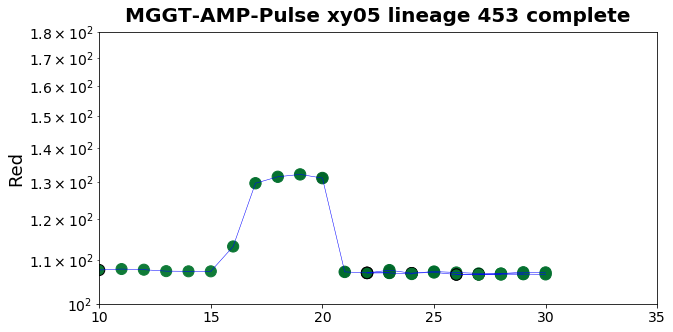

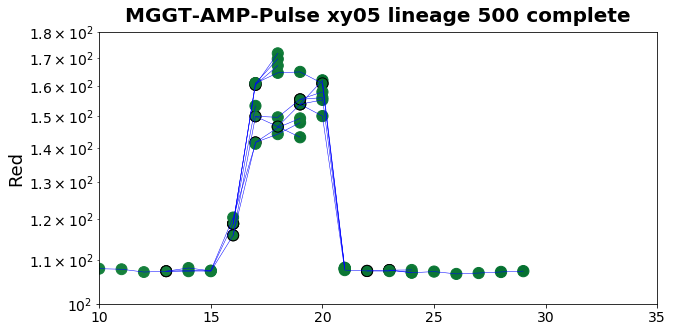

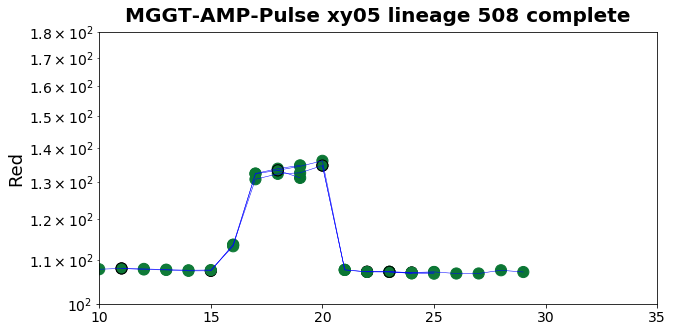

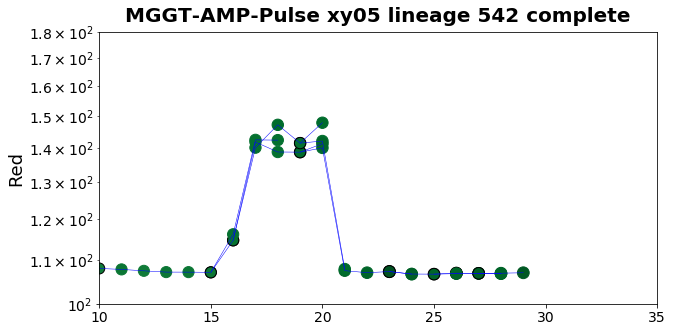

xy06


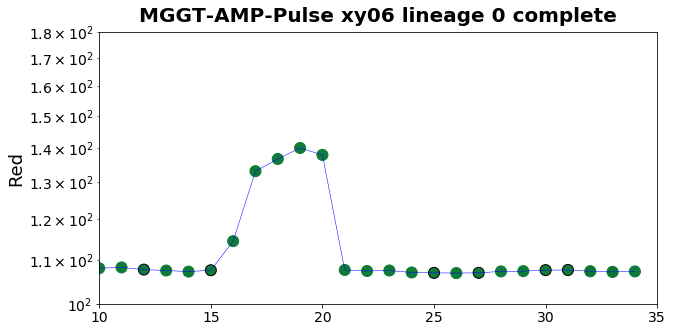

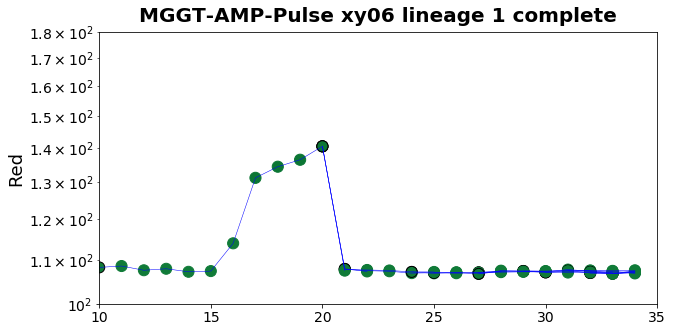

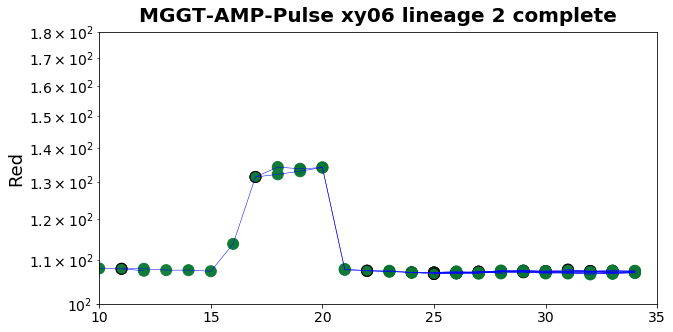

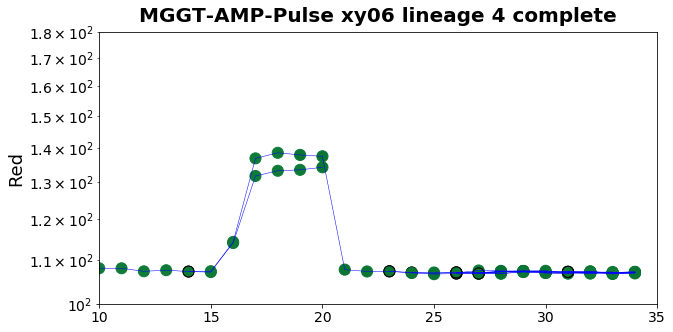

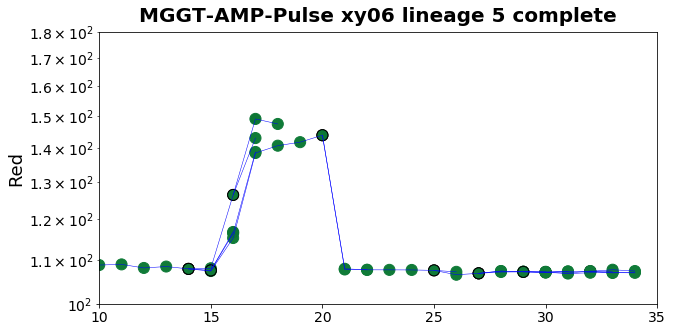

...

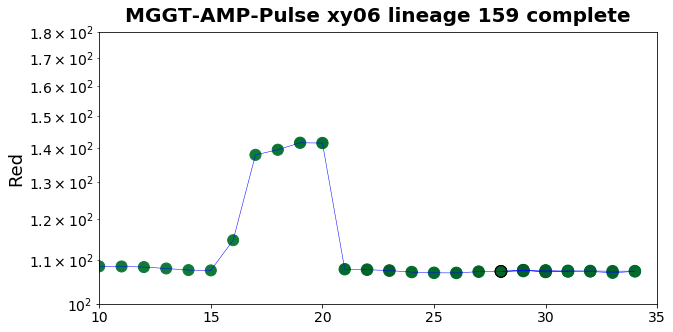

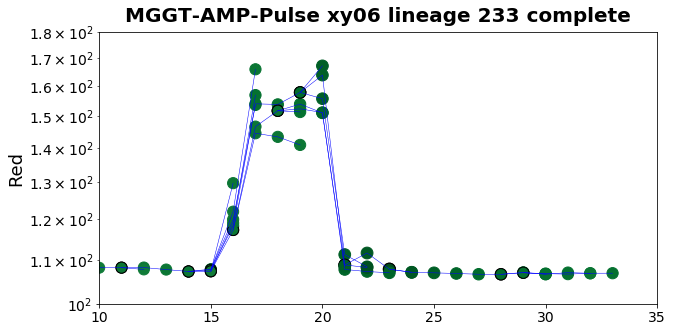

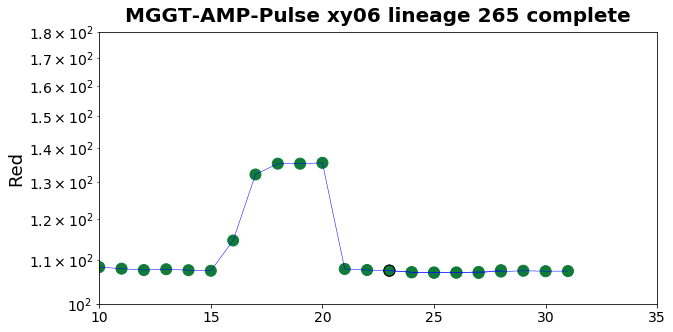

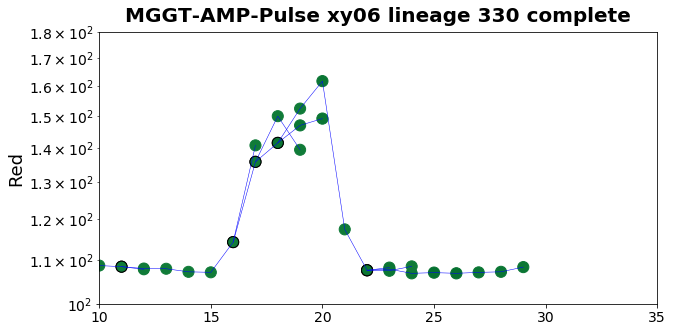

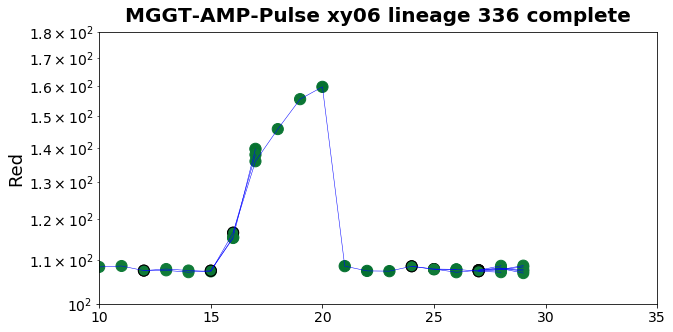

xy07


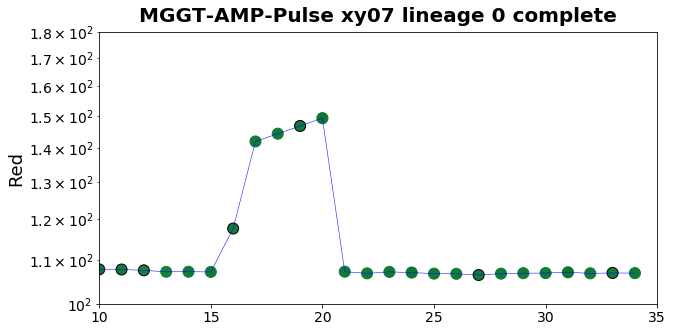

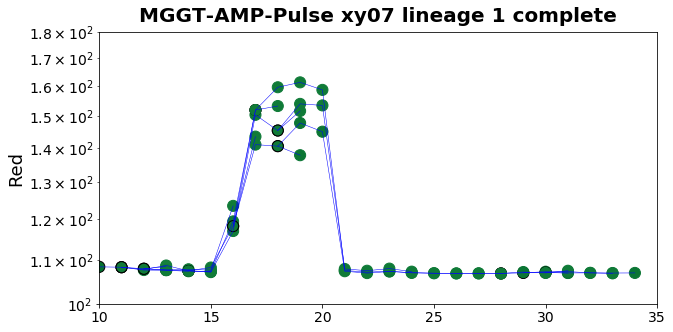

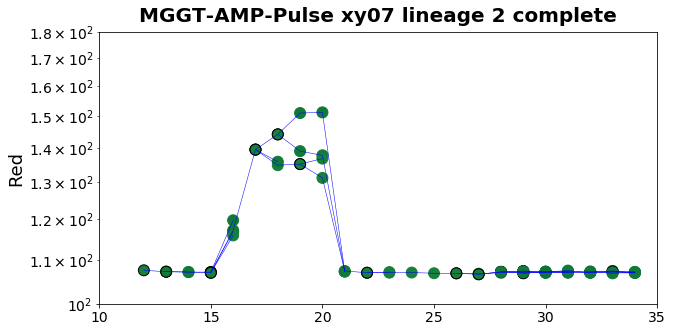

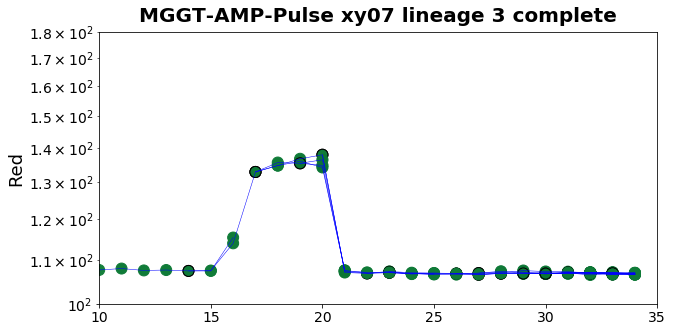

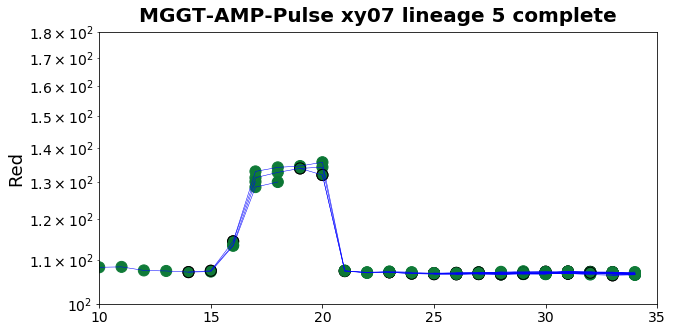

...

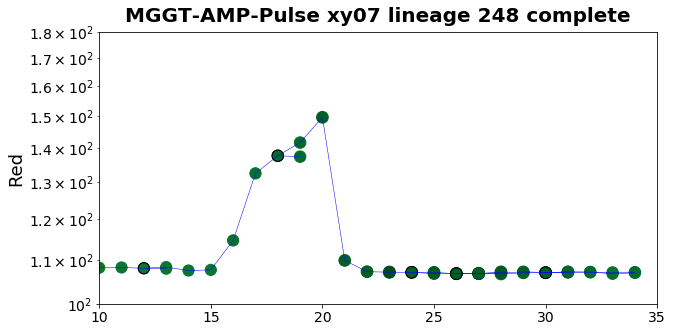

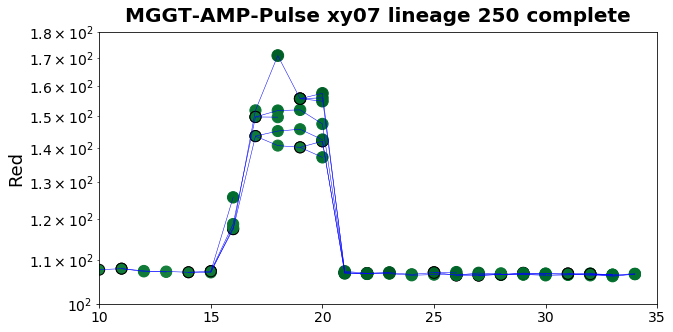

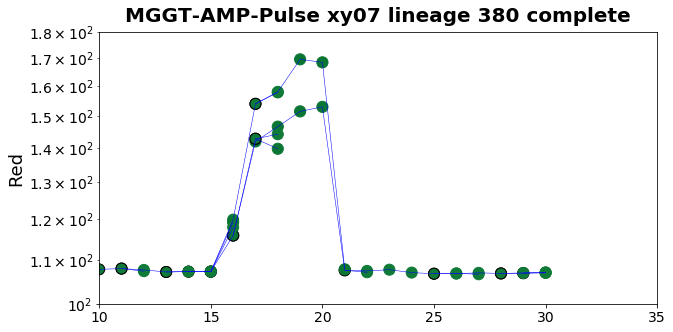

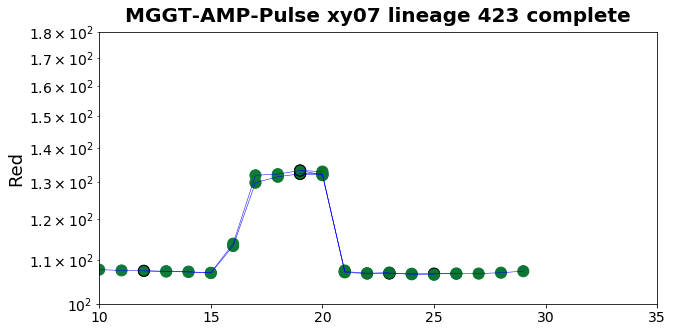

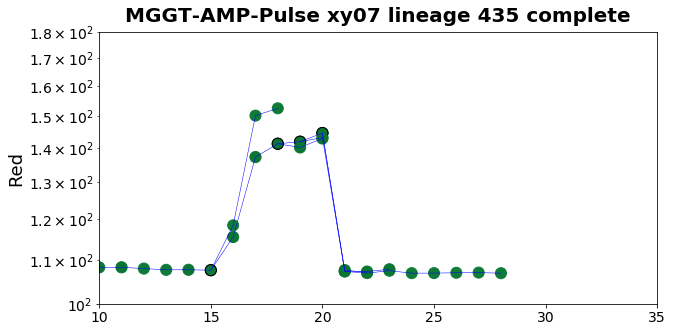

xy09


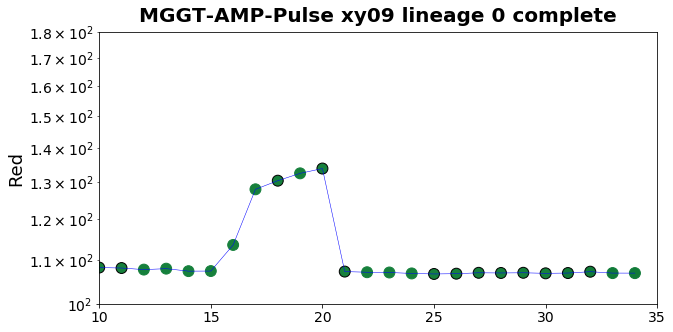

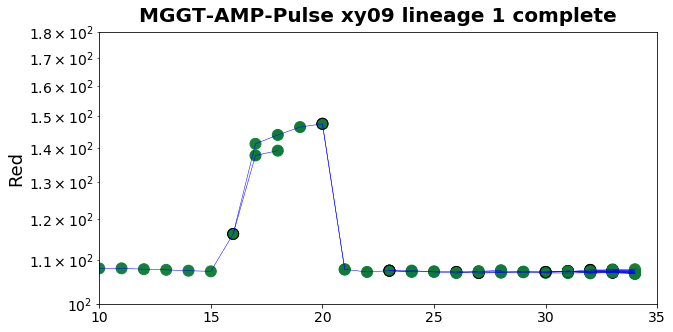

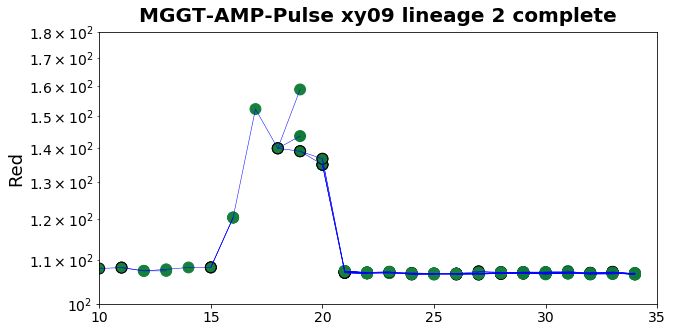

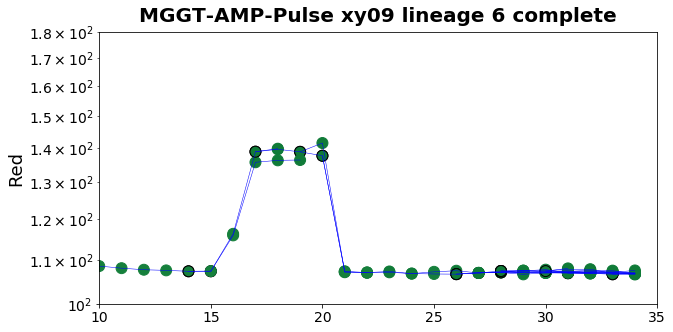

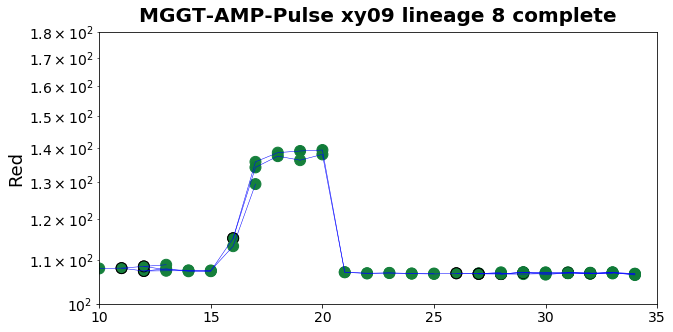

...

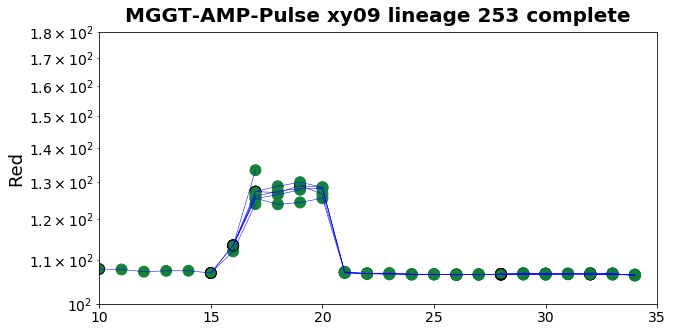

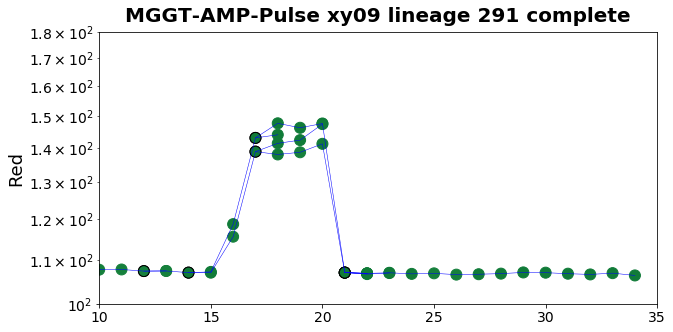

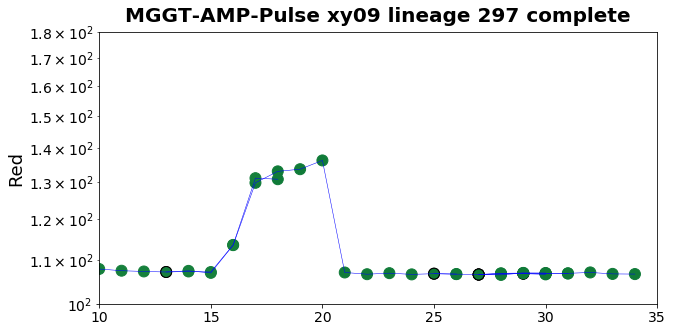

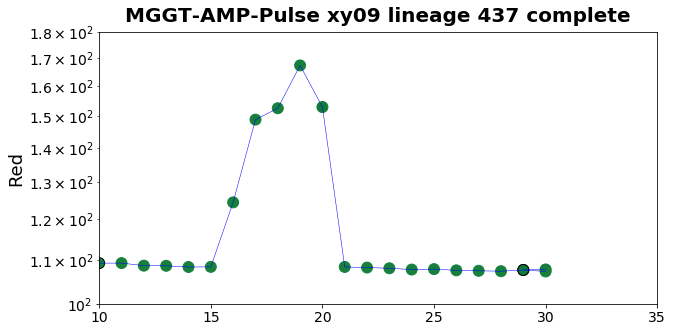

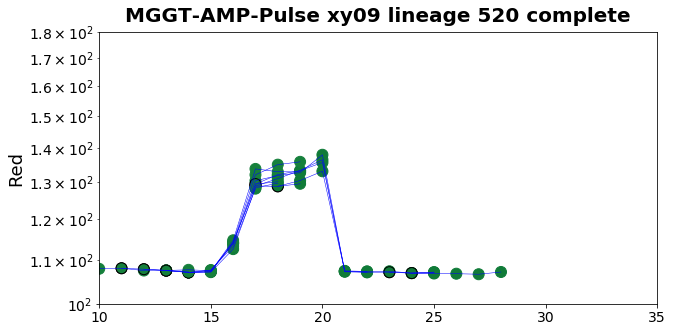

xy12


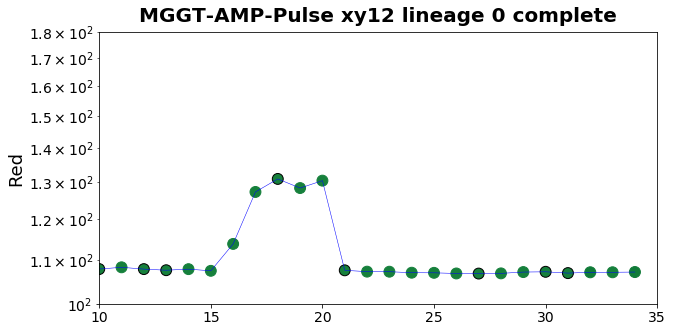

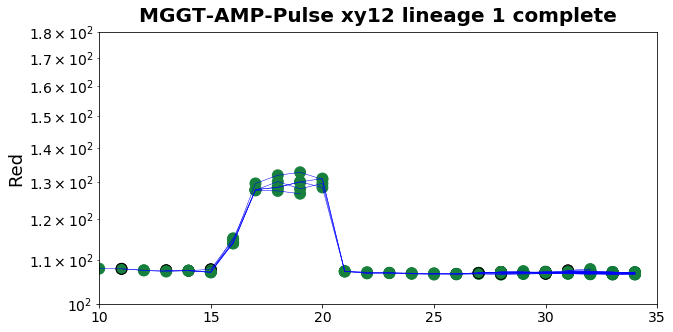

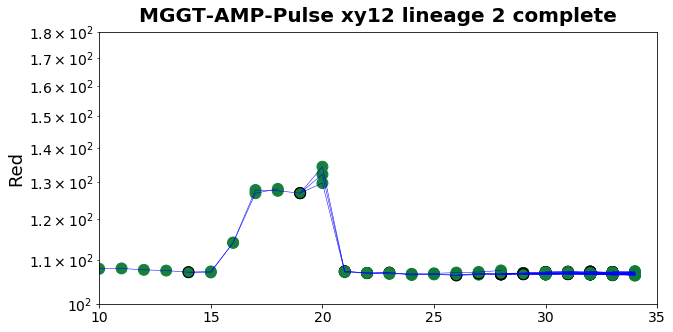

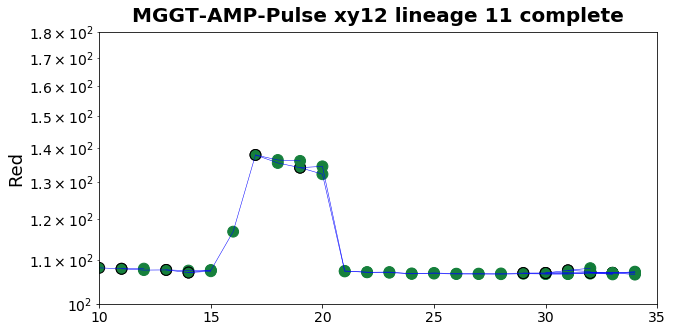

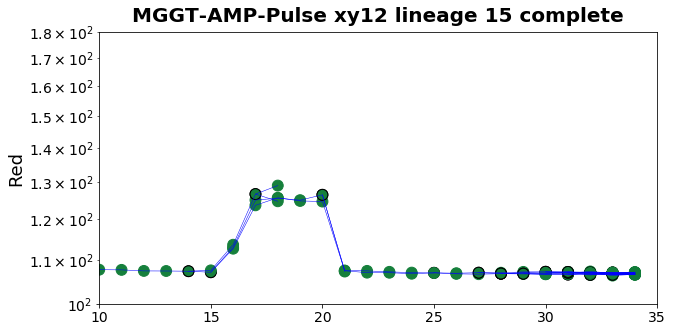

...

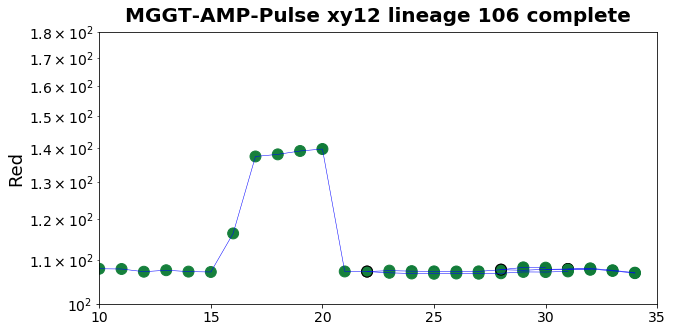

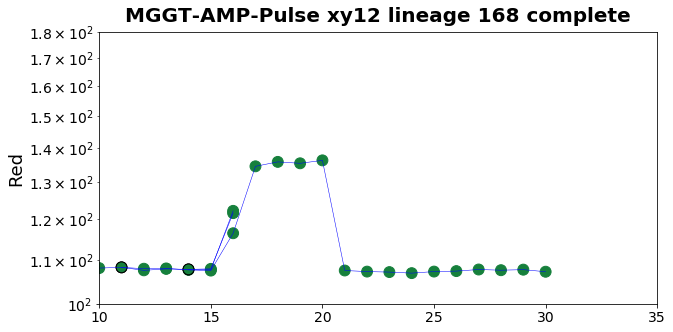

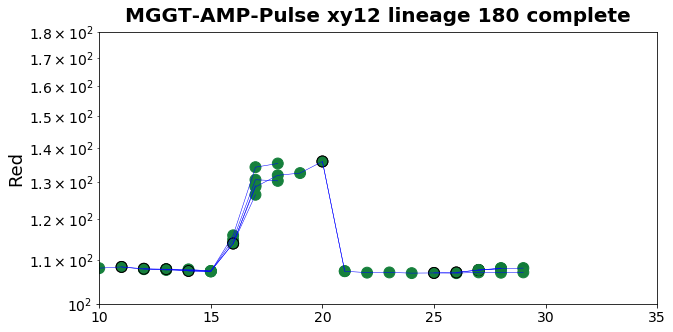

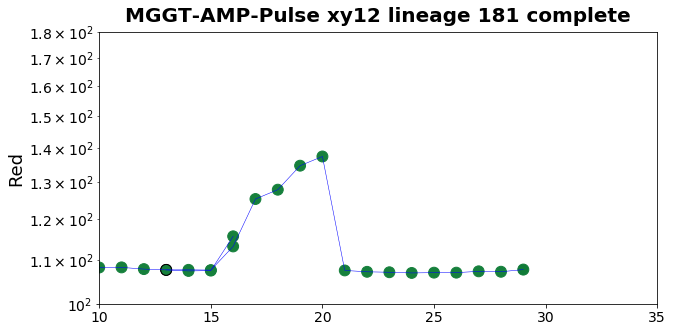

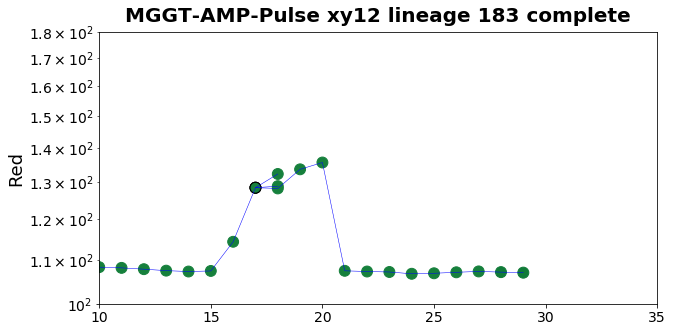

xy13


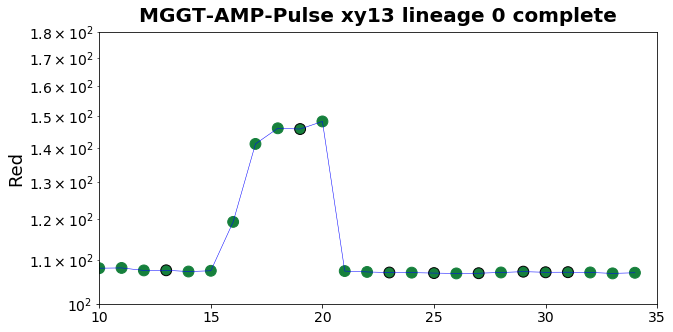

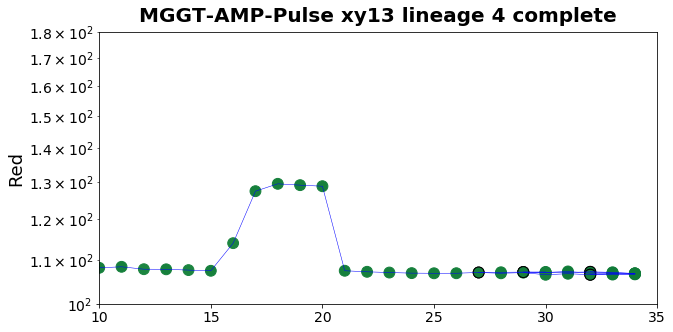

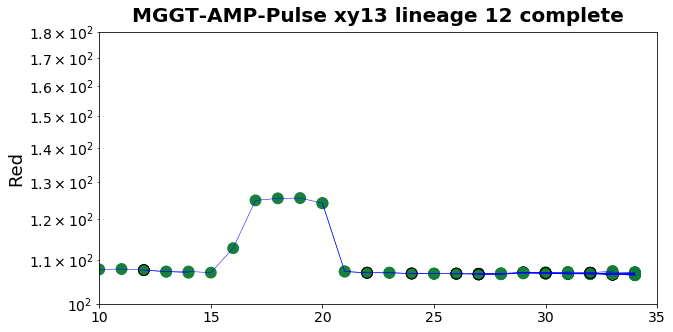

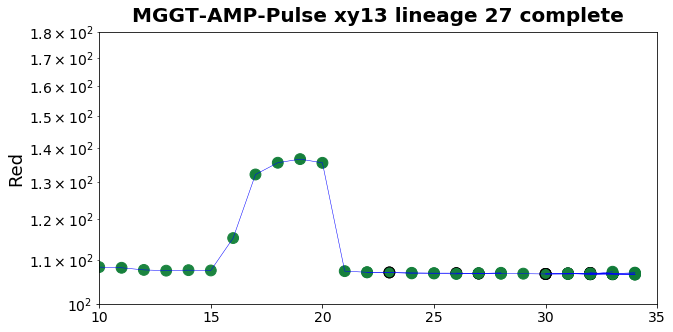

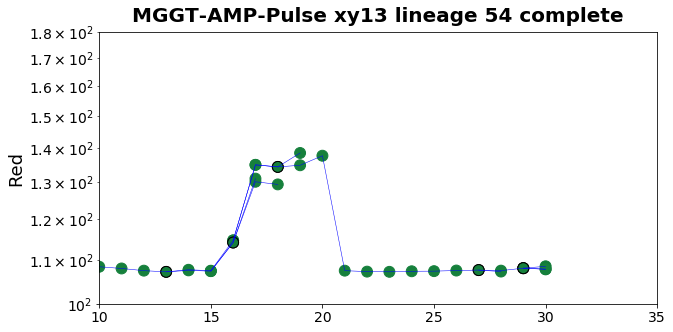

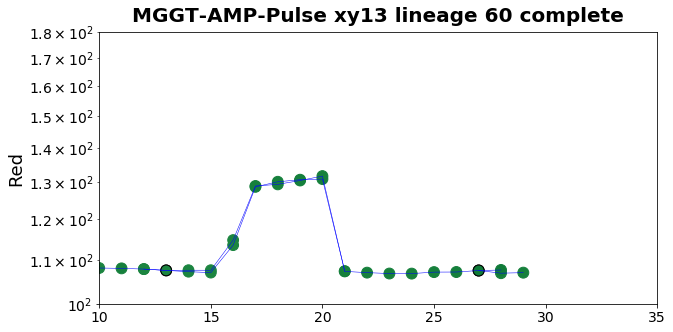

In [143]:
ncolors=50
cmap = cm.get_cmap("Greens", ncolors)
maxgfp=150
def plot_fancy_tracks(ax,this_df,alphs,alphp):
    
    gfps=list(this_df["GFP"])
    reds=list(this_df["DsRed"])
    frames=list(this_df["frame"])
    divs=list(this_df["division"])
    
    ss=[x for x in gfps]
    #  meanPhi_Nrot,maxRho_N,meanRho_N  
    colors=cmap([x/maxgfp for x in gfps])
    ecolors=colors.copy()
    for ic,div in enumerate(divs):
        if div==1:
            ecolors[ic]=(0.0, 0.0, 0.0, 1.0)
    
    
    
    if(alphs==1):
        ax.scatter(frames,reds,s=ss,c=colors,alpha=alphs,edgecolors=ecolors,zorder=2)
        ax.plot(frames, reds,c='b',linewidth=.5,alpha=alphp,zorder=2)
    else:
        ax.scatter(frames,reds,s=ss,c=colors,alpha=alphs)
        ax.plot(frames, reds,c='k',linewidth=.85,alpha=alphp)

    return ax

minFramesThr=frame_experiment_end-frame_experiment_start-5
trap_df_lineages=trap_df_lineages_all
list_frames=list_frames_all
for i,trap in enumerate(trap_list):
    dir_images=rootDir+'figures/lineages/complete_lineages/'+trap+"/"
    if not os.path.exists(dir_images):
        os.makedirs(dir_images)

    
    df_lineages=trap_df_lineages[i]
    print(trap)

    for linID in df_lineages.lineageID.unique():

        this_ldf=df_lineages[df_lineages["lineageID"]==linID]
        frames=this_ldf.frame.unique()
        nframes=len(frames)
        if(nframes<minFramesThr):
            continue
        fig= plt.figure( figsize=(10, 5))
        ax=plt.subplot()
        longest_track=""
        maxFrames=0
        for trackID in this_ldf.trackID.unique():
            this_tdf=this_ldf[this_ldf["trackID"]==trackID]
            frames=this_tdf.frame.unique()
            nframes=len(frames)
            if maxFrames<nframes: 
                maxFrames=nframes
                longest_track=trackID

        for trackID in this_ldf.trackID.unique():
            #alphs=.1
            #alphp=.25
            alphs=1
            alphp=1
            if trackID==longest_track:
                alphs=1
                alphp=1

            this_tdf=this_ldf[this_ldf["trackID"]==trackID]
            ax=plot_fancy_tracks(ax,this_tdf,alphs,alphp)
       # yt=np.linspace(0,3,7)
            #print(yt)
        #ax.set_yticks(yt)
        #yts1=ax.get_yticklabels()
        
        #ytl=[str(y) for y in yts1]
        #ytc=cmap([1-y/np.pi for y in yt])
        
#         for ticklabel, tickcolor in zip(yts1, ytc):
#             ticklabel.set_color(tickcolor)
#             ticklabel.set_fontsize(18)
        ax.set_ylabel("Red",fontsize=18)
        
        ax.set_xlim(xmin=list_frames[0],xmax=list_frames[-1]+1)
        ax.set_ylim(ymin=100,ymax=180)
        ax.set_yscale('log')
        ax.set_title("%s %s lineage %s complete"%(expeLabel,trap,linID), va='bottom',fontweight='bold',fontsize=20)
        figName="%s%s_%s_lineage-%s_complete.png"%(dir_images,expeLabel,trap,linID)
        plt.savefig(figName)
        plt.show()